# Afriat

In [1]:
scan=0.14

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: a303trcp
Name: elegant-pilot-133
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/a303trcp
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-a303trcp/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2572,3249,9422
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2572,2575,1690,3449,1621,3336
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4490,10753
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 633,860,2317
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 633,627,418,841,428,863
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1094,2716
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:22:53, 14.31s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:22:53, 14.31s/it, v_num=cp_1, total_loss_train=3.68e+3, kl_local_train=51.5]

Epoch 2/600:   0%|          | 1/600 [00:14<2:22:53, 14.31s/it, v_num=cp_1, total_loss_train=3.68e+3, kl_local_train=51.5]

Epoch 2/600:   0%|          | 2/600 [00:27<2:14:02, 13.45s/it, v_num=cp_1, total_loss_train=3.68e+3, kl_local_train=51.5]

Epoch 2/600:   0%|          | 2/600 [00:27<2:14:02, 13.45s/it, v_num=cp_1, total_loss_train=3.23e+3, kl_local_train=80.2]

Epoch 3/600:   0%|          | 2/600 [00:27<2:14:02, 13.45s/it, v_num=cp_1, total_loss_train=3.23e+3, kl_local_train=80.2]

Epoch 3/600:   0%|          | 3/600 [00:40<2:11:09, 13.18s/it, v_num=cp_1, total_loss_train=3.23e+3, kl_local_train=80.2]

Epoch 3/600:   0%|          | 3/600 [00:40<2:11:09, 13.18s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=82]  

Epoch 4/600:   0%|          | 3/600 [00:40<2:11:09, 13.18s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=82]

Epoch 4/600:   1%|          | 4/600 [00:52<2:09:21, 13.02s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=82]

Epoch 4/600:   1%|          | 4/600 [00:52<2:09:21, 13.02s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=78.5]

Epoch 5/600:   1%|          | 4/600 [00:52<2:09:21, 13.02s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=78.5]

Epoch 5/600:   1%|          | 5/600 [01:05<2:08:10, 12.93s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=78.5]

Epoch 5/600:   1%|          | 5/600 [01:05<2:08:10, 12.93s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=70.6]

Epoch 6/600:   1%|          | 5/600 [01:07<2:08:10, 12.93s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=70.6]

Epoch 6/600:   1%|          | 6/600 [01:19<2:11:08, 13.25s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=70.6]

Epoch 6/600:   1%|          | 6/600 [01:19<2:11:08, 13.25s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 6/600 [01:19<2:11:08, 13.25s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:31<2:07:42, 12.92s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=56.7, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 7/600:   1%|          | 7/600 [01:31<2:07:42, 12.92s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|          | 7/600 [01:31<2:07:42, 12.92s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:44<2:06:23, 12.81s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 8/600:   1%|▏         | 8/600 [01:44<2:06:23, 12.81s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=35.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035] 

Epoch 9/600:   1%|▏         | 8/600 [01:44<2:06:23, 12.81s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=35.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:56<2:04:06, 12.60s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=35.2, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 9/600:   2%|▏         | 9/600 [01:56<2:04:06, 12.60s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=30.3, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 9/600 [01:56<2:04:06, 12.60s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=30.3, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:08<2:03:38, 12.57s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=30.3, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 10/600:   2%|▏         | 10/600 [02:08<2:03:38, 12.57s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=37, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]  

Epoch 11/600:   2%|▏         | 10/600 [02:10<2:03:38, 12.57s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=37, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:22<2:06:45, 12.91s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=37, metric_mi|status_control_train=0.0183, metric_mi|zone_train=0.00877, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.035]

Epoch 11/600:   2%|▏         | 11/600 [02:22<2:06:45, 12.91s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 12/600:   2%|▏         | 11/600 [02:22<2:06:45, 12.91s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 12/600:   2%|▏         | 12/600 [02:34<2:04:54, 12.75s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 12/600:   2%|▏         | 12/600 [02:34<2:04:54, 12.75s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 13/600:   2%|▏         | 12/600 [02:34<2:04:54, 12.75s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 13/600:   2%|▏         | 13/600 [02:47<2:03:19, 12.61s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 13/600:   2%|▏         | 13/600 [02:47<2:03:19, 12.61s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 14/600:   2%|▏         | 13/600 [02:47<2:03:19, 12.61s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 14/600:   2%|▏         | 14/600 [02:59<2:02:19, 12.52s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 14/600:   2%|▏         | 14/600 [02:59<2:02:19, 12.52s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 15/600:   2%|▏         | 14/600 [02:59<2:02:19, 12.52s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 15/600:   2%|▎         | 15/600 [03:11<2:01:49, 12.49s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 15/600:   2%|▎         | 15/600 [03:11<2:01:49, 12.49s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=59, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]  

Epoch 16/600:   2%|▎         | 15/600 [03:13<2:01:49, 12.49s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=59, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 16/600:   3%|▎         | 16/600 [03:25<2:05:15, 12.87s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=59, metric_mi|status_control_train=0.0259, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0223, metric_mi|mouse_train=0.0482]

Epoch 16/600:   3%|▎         | 16/600 [03:25<2:05:15, 12.87s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 17/600:   3%|▎         | 16/600 [03:25<2:05:15, 12.87s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 17/600:   3%|▎         | 17/600 [03:38<2:03:39, 12.73s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 17/600:   3%|▎         | 17/600 [03:38<2:03:39, 12.73s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=69.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 18/600:   3%|▎         | 17/600 [03:38<2:03:39, 12.73s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=69.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 18/600:   3%|▎         | 18/600 [03:50<2:01:37, 12.54s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=69.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 18/600:   3%|▎         | 18/600 [03:50<2:01:37, 12.54s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=74.4, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 19/600:   3%|▎         | 18/600 [03:50<2:01:37, 12.54s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=74.4, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 19/600:   3%|▎         | 19/600 [04:02<2:00:54, 12.49s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=74.4, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 19/600:   3%|▎         | 19/600 [04:02<2:00:54, 12.49s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=78.4, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 20/600:   3%|▎         | 19/600 [04:02<2:00:54, 12.49s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=78.4, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 20/600:   3%|▎         | 20/600 [04:14<2:00:25, 12.46s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=78.4, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 20/600:   3%|▎         | 20/600 [04:14<2:00:25, 12.46s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=83.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 21/600:   3%|▎         | 20/600 [04:16<2:00:25, 12.46s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=83.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 21/600:   4%|▎         | 21/600 [04:28<2:04:06, 12.86s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=83.7, metric_mi|status_control_train=0.0264, metric_mi|zone_train=0.0589, metric_mi|time_cat_train=0.0454, metric_mi|mouse_train=0.0681]

Epoch 21/600:   4%|▎         | 21/600 [04:28<2:04:06, 12.86s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 22/600:   4%|▎         | 21/600 [04:28<2:04:06, 12.86s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 22/600:   4%|▎         | 22/600 [04:41<2:02:44, 12.74s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=86.2, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 22/600:   4%|▎         | 22/600 [04:41<2:02:44, 12.74s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=90.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 23/600:   4%|▎         | 22/600 [04:41<2:02:44, 12.74s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=90.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 23/600:   4%|▍         | 23/600 [04:53<2:01:42, 12.66s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=90.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 23/600:   4%|▍         | 23/600 [04:53<2:01:42, 12.66s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 24/600:   4%|▍         | 23/600 [04:53<2:01:42, 12.66s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 24/600:   4%|▍         | 24/600 [05:06<2:01:04, 12.61s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 24/600:   4%|▍         | 24/600 [05:06<2:01:04, 12.61s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839] 

Epoch 25/600:   4%|▍         | 24/600 [05:06<2:01:04, 12.61s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 25/600:   4%|▍         | 25/600 [05:18<2:00:44, 12.60s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 25/600:   4%|▍         | 25/600 [05:18<2:00:44, 12.60s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 26/600:   4%|▍         | 25/600 [05:20<2:00:44, 12.60s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 26/600:   4%|▍         | 26/600 [05:32<2:04:52, 13.05s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=108, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0839]

Epoch 26/600:   4%|▍         | 26/600 [05:32<2:04:52, 13.05s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 27/600:   4%|▍         | 26/600 [05:32<2:04:52, 13.05s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 27/600:   4%|▍         | 27/600 [05:45<2:03:09, 12.90s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=113, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 27/600:   4%|▍         | 27/600 [05:45<2:03:09, 12.90s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 28/600:   4%|▍         | 27/600 [05:45<2:03:09, 12.90s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 28/600:   5%|▍         | 28/600 [05:58<2:02:43, 12.87s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 28/600:   5%|▍         | 28/600 [05:58<2:02:43, 12.87s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 29/600:   5%|▍         | 28/600 [05:58<2:02:43, 12.87s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 29/600:   5%|▍         | 29/600 [06:10<2:01:19, 12.75s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=116, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 29/600:   5%|▍         | 29/600 [06:10<2:01:19, 12.75s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 30/600:   5%|▍         | 29/600 [06:10<2:01:19, 12.75s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 30/600:   5%|▌         | 30/600 [06:23<2:01:53, 12.83s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=112, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 30/600:   5%|▌         | 30/600 [06:23<2:01:53, 12.83s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 31/600:   5%|▌         | 30/600 [06:25<2:01:53, 12.83s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 31/600:   5%|▌         | 31/600 [06:37<2:04:34, 13.14s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=109, metric_mi|status_control_train=0.0567, metric_mi|zone_train=0.0592, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0936]

Epoch 31/600:   5%|▌         | 31/600 [06:37<2:04:34, 13.14s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]  

Epoch 32/600:   5%|▌         | 31/600 [06:37<2:04:34, 13.14s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 32/600:   5%|▌         | 32/600 [06:50<2:02:30, 12.94s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=106, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 32/600:   5%|▌         | 32/600 [06:50<2:02:30, 12.94s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 33/600:   5%|▌         | 32/600 [06:50<2:02:30, 12.94s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 33/600:   6%|▌         | 33/600 [07:02<2:00:56, 12.80s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=103, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 33/600:   6%|▌         | 33/600 [07:02<2:00:56, 12.80s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 34/600:   6%|▌         | 33/600 [07:02<2:00:56, 12.80s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 34/600:   6%|▌         | 34/600 [07:14<1:59:05, 12.63s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 34/600:   6%|▌         | 34/600 [07:14<1:59:05, 12.63s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=98, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109] 

Epoch 35/600:   6%|▌         | 34/600 [07:14<1:59:05, 12.63s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=98, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 35/600:   6%|▌         | 35/600 [07:27<2:00:05, 12.75s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=98, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 35/600:   6%|▌         | 35/600 [07:27<2:00:05, 12.75s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=97.3, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 36/600:   6%|▌         | 35/600 [07:29<2:00:05, 12.75s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=97.3, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 36/600:   6%|▌         | 36/600 [07:41<2:02:49, 13.07s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=97.3, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.106, metric_mi|mouse_train=0.109]

Epoch 36/600:   6%|▌         | 36/600 [07:41<2:02:49, 13.07s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=97.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]    

Epoch 37/600:   6%|▌         | 36/600 [07:41<2:02:49, 13.07s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=97.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 37/600 [07:54<2:01:05, 12.91s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=97.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 37/600 [07:54<2:01:05, 12.91s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=96.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▌         | 37/600 [07:54<2:01:05, 12.91s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=96.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▋         | 38/600 [08:06<1:59:59, 12.81s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=96.3, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▋         | 38/600 [08:06<1:59:59, 12.81s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=95.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 38/600 [08:06<1:59:59, 12.81s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=95.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 39/600 [08:18<1:56:37, 12.47s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=95.5, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 39/600 [08:18<1:56:37, 12.47s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 40/600:   6%|▋         | 39/600 [08:18<1:56:37, 12.47s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 40/600:   7%|▋         | 40/600 [08:30<1:54:41, 12.29s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=95.6, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 40/600:   7%|▋         | 40/600 [08:30<1:54:41, 12.29s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=94.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 40/600 [08:31<1:54:41, 12.29s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=94.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 41/600 [08:43<1:56:14, 12.48s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=94.2, metric_mi|status_control_train=0.112, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 41/600 [08:43<1:56:14, 12.48s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=96.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 42/600:   7%|▋         | 41/600 [08:43<1:56:14, 12.48s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=96.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 42/600:   7%|▋         | 42/600 [08:55<1:54:31, 12.32s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=96.1, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 42/600:   7%|▋         | 42/600 [08:55<1:54:31, 12.32s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=95.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 43/600:   7%|▋         | 42/600 [08:55<1:54:31, 12.32s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=95.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 43/600:   7%|▋         | 43/600 [09:07<1:53:11, 12.19s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=95.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 43/600:   7%|▋         | 43/600 [09:07<1:53:11, 12.19s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=97.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 44/600:   7%|▋         | 43/600 [09:07<1:53:11, 12.19s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=97.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 44/600:   7%|▋         | 44/600 [09:18<1:52:07, 12.10s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=97.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 44/600:   7%|▋         | 44/600 [09:18<1:52:07, 12.10s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=97.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 45/600:   7%|▋         | 44/600 [09:18<1:52:07, 12.10s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=97.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 45/600:   8%|▊         | 45/600 [09:31<1:52:18, 12.14s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=97.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 45/600:   8%|▊         | 45/600 [09:31<1:52:18, 12.14s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 46/600:   8%|▊         | 45/600 [09:32<1:52:18, 12.14s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 46/600:   8%|▊         | 46/600 [09:44<1:55:03, 12.46s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.129, metric_mi|mouse_train=0.122]

Epoch 46/600:   8%|▊         | 46/600 [09:44<1:55:03, 12.46s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=99.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 47/600:   8%|▊         | 46/600 [09:44<1:55:03, 12.46s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=99.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 47/600:   8%|▊         | 47/600 [09:56<1:53:12, 12.28s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=99.4, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 47/600:   8%|▊         | 47/600 [09:56<1:53:12, 12.28s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=99.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 48/600:   8%|▊         | 47/600 [09:56<1:53:12, 12.28s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=99.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 48/600:   8%|▊         | 48/600 [10:08<1:53:18, 12.32s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=99.5, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 48/600:   8%|▊         | 48/600 [10:08<1:53:18, 12.32s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=98.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 49/600:   8%|▊         | 48/600 [10:08<1:53:18, 12.32s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=98.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 49/600:   8%|▊         | 49/600 [10:21<1:54:15, 12.44s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=98.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 49/600:   8%|▊         | 49/600 [10:21<1:54:15, 12.44s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=98.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 50/600:   8%|▊         | 49/600 [10:21<1:54:15, 12.44s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=98.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 50/600:   8%|▊         | 50/600 [10:34<1:55:43, 12.63s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=98.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 50/600:   8%|▊         | 50/600 [10:34<1:55:43, 12.63s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=97.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 51/600:   8%|▊         | 50/600 [10:35<1:55:43, 12.63s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=97.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 51/600:   8%|▊         | 51/600 [10:48<1:58:53, 12.99s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=97.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 51/600:   8%|▊         | 51/600 [10:48<1:58:53, 12.99s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=98, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]  

Epoch 52/600:   8%|▊         | 51/600 [10:48<1:58:53, 12.99s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=98, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 52/600:   9%|▊         | 52/600 [11:00<1:57:11, 12.83s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=98, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 52/600:   9%|▊         | 52/600 [11:00<1:57:11, 12.83s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=96.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|▊         | 52/600 [11:00<1:57:11, 12.83s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=96.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|▉         | 53/600 [11:13<1:56:31, 12.78s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=96.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 53/600:   9%|▉         | 53/600 [11:13<1:56:31, 12.78s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=96.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|▉         | 53/600 [11:13<1:56:31, 12.78s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=96.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|▉         | 54/600 [11:26<1:56:22, 12.79s/it, v_num=cp_1, total_loss_train=3.22e+3, kl_local_train=96.6, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 54/600:   9%|▉         | 54/600 [11:26<1:56:22, 12.79s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=94.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|▉         | 54/600 [11:26<1:56:22, 12.79s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=94.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|▉         | 55/600 [11:39<1:56:58, 12.88s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=94.8, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 55/600:   9%|▉         | 55/600 [11:39<1:56:58, 12.88s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=94.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|▉         | 55/600 [11:40<1:56:58, 12.88s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=94.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|▉         | 56/600 [11:53<1:59:31, 13.18s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=94.7, metric_mi|status_control_train=0.183, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.127]

Epoch 56/600:   9%|▉         | 56/600 [11:53<1:59:31, 13.18s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=94.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 57/600:   9%|▉         | 56/600 [11:53<1:59:31, 13.18s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=94.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 57/600:  10%|▉         | 57/600 [12:05<1:57:06, 12.94s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=94.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 57/600:  10%|▉         | 57/600 [12:05<1:57:06, 12.94s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=92.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|▉         | 57/600 [12:05<1:57:06, 12.94s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=92.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|▉         | 58/600 [12:17<1:55:29, 12.79s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=92.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 58/600:  10%|▉         | 58/600 [12:17<1:55:29, 12.79s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=92, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]  

Epoch 59/600:  10%|▉         | 58/600 [12:17<1:55:29, 12.79s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=92, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|▉         | 59/600 [12:30<1:54:49, 12.73s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=92, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 59/600:  10%|▉         | 59/600 [12:30<1:54:49, 12.73s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=91.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|▉         | 59/600 [12:30<1:54:49, 12.73s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=91.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|█         | 60/600 [12:43<1:53:56, 12.66s/it, v_num=cp_1, total_loss_train=3.21e+3, kl_local_train=91.4, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 60/600:  10%|█         | 60/600 [12:43<1:53:56, 12.66s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=91.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127] 

Epoch 61/600:  10%|█         | 60/600 [12:44<1:53:56, 12.66s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=91.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 61/600:  10%|█         | 61/600 [12:57<1:57:51, 13.12s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=91.5, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.127]

Epoch 61/600:  10%|█         | 61/600 [12:57<1:57:51, 13.12s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=90.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 62/600:  10%|█         | 61/600 [12:57<1:57:51, 13.12s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=90.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 62/600:  10%|█         | 62/600 [13:10<1:56:57, 13.04s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=90.3, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 62/600:  10%|█         | 62/600 [13:10<1:56:57, 13.04s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=90.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 63/600:  10%|█         | 62/600 [13:10<1:56:57, 13.04s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=90.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 63/600:  10%|█         | 63/600 [13:23<1:56:27, 13.01s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=90.6, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 63/600:  10%|█         | 63/600 [13:23<1:56:27, 13.01s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=88.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 64/600:  10%|█         | 63/600 [13:23<1:56:27, 13.01s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=88.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 64/600:  11%|█         | 64/600 [13:35<1:55:05, 12.88s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=88.7, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 64/600:  11%|█         | 64/600 [13:35<1:55:05, 12.88s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=88.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 65/600:  11%|█         | 64/600 [13:35<1:55:05, 12.88s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=88.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 65/600:  11%|█         | 65/600 [13:48<1:55:27, 12.95s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=88.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 65/600:  11%|█         | 65/600 [13:48<1:55:27, 12.95s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 66/600:  11%|█         | 65/600 [13:50<1:55:27, 12.95s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 66/600:  11%|█         | 66/600 [14:02<1:58:42, 13.34s/it, v_num=cp_1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.125]

Epoch 66/600:  11%|█         | 66/600 [14:02<1:58:42, 13.34s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=87.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 67/600:  11%|█         | 66/600 [14:02<1:58:42, 13.34s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=87.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 67/600:  11%|█         | 67/600 [14:15<1:57:15, 13.20s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=87.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 67/600:  11%|█         | 67/600 [14:15<1:57:15, 13.20s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=86.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 68/600:  11%|█         | 67/600 [14:15<1:57:15, 13.20s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=86.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 68/600:  11%|█▏        | 68/600 [14:28<1:56:43, 13.16s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=86.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 68/600:  11%|█▏        | 68/600 [14:28<1:56:43, 13.16s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=86, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]  

Epoch 69/600:  11%|█▏        | 68/600 [14:28<1:56:43, 13.16s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=86, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 69/600:  12%|█▏        | 69/600 [14:41<1:55:54, 13.10s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=86, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 69/600:  12%|█▏        | 69/600 [14:41<1:55:54, 13.10s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=85, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 70/600:  12%|█▏        | 69/600 [14:41<1:55:54, 13.10s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=85, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 70/600:  12%|█▏        | 70/600 [14:55<1:55:46, 13.11s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=85, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 70/600:  12%|█▏        | 70/600 [14:55<1:55:46, 13.11s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 71/600:  12%|█▏        | 70/600 [14:56<1:55:46, 13.11s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 71/600:  12%|█▏        | 71/600 [15:09<1:58:40, 13.46s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=84.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 71/600:  12%|█▏        | 71/600 [15:09<1:58:40, 13.46s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=83.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121] 

Epoch 72/600:  12%|█▏        | 71/600 [15:09<1:58:40, 13.46s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=83.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 72/600:  12%|█▏        | 72/600 [15:21<1:56:12, 13.21s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=83.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 72/600:  12%|█▏        | 72/600 [15:21<1:56:12, 13.21s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=83.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 73/600:  12%|█▏        | 72/600 [15:21<1:56:12, 13.21s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=83.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 73/600:  12%|█▏        | 73/600 [15:34<1:55:16, 13.12s/it, v_num=cp_1, total_loss_train=3.19e+3, kl_local_train=83.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 73/600:  12%|█▏        | 73/600 [15:34<1:55:16, 13.12s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=82.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 74/600:  12%|█▏        | 73/600 [15:34<1:55:16, 13.12s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=82.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 74/600:  12%|█▏        | 74/600 [15:47<1:54:40, 13.08s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=82.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 74/600:  12%|█▏        | 74/600 [15:47<1:54:40, 13.08s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=82.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 75/600:  12%|█▏        | 74/600 [15:47<1:54:40, 13.08s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=82.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 75/600:  12%|█▎        | 75/600 [16:00<1:54:34, 13.09s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=82.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 75/600:  12%|█▎        | 75/600 [16:00<1:54:34, 13.09s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=81.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 76/600:  12%|█▎        | 75/600 [16:02<1:54:34, 13.09s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=81.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 76/600:  13%|█▎        | 76/600 [16:15<1:57:10, 13.42s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=81.2, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.121]

Epoch 76/600:  13%|█▎        | 76/600 [16:15<1:57:10, 13.42s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 77/600:  13%|█▎        | 76/600 [16:15<1:57:10, 13.42s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 77/600:  13%|█▎        | 77/600 [16:27<1:54:56, 13.19s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=81.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 77/600:  13%|█▎        | 77/600 [16:27<1:54:56, 13.19s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=80, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]  

Epoch 78/600:  13%|█▎        | 77/600 [16:27<1:54:56, 13.19s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=80, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 78/600:  13%|█▎        | 78/600 [16:40<1:54:07, 13.12s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=80, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 78/600:  13%|█▎        | 78/600 [16:40<1:54:07, 13.12s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=80, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 79/600:  13%|█▎        | 78/600 [16:40<1:54:07, 13.12s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=80, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 79/600:  13%|█▎        | 79/600 [16:53<1:53:28, 13.07s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=80, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 79/600:  13%|█▎        | 79/600 [16:53<1:53:28, 13.07s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=79, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 80/600:  13%|█▎        | 79/600 [16:53<1:53:28, 13.07s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=79, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 80/600:  13%|█▎        | 80/600 [17:06<1:53:36, 13.11s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=79, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 80/600:  13%|█▎        | 80/600 [17:06<1:53:36, 13.11s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 81/600:  13%|█▎        | 80/600 [17:08<1:53:36, 13.11s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 81/600:  14%|█▎        | 81/600 [17:21<1:56:18, 13.45s/it, v_num=cp_1, total_loss_train=3.18e+3, kl_local_train=78.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.126, metric_mi|mouse_train=0.119]

Epoch 81/600:  14%|█▎        | 81/600 [17:21<1:56:18, 13.45s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=78.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117] 

Epoch 82/600:  14%|█▎        | 81/600 [17:21<1:56:18, 13.45s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=78.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 82/600:  14%|█▎        | 82/600 [17:33<1:54:04, 13.21s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=78.4, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 82/600:  14%|█▎        | 82/600 [17:33<1:54:04, 13.21s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=78.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 83/600:  14%|█▎        | 82/600 [17:33<1:54:04, 13.21s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=78.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 83/600:  14%|█▍        | 83/600 [17:46<1:53:12, 13.14s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=78.1, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 83/600:  14%|█▍        | 83/600 [17:46<1:53:12, 13.14s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=77.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 84/600:  14%|█▍        | 83/600 [17:46<1:53:12, 13.14s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=77.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 84/600:  14%|█▍        | 84/600 [17:59<1:52:24, 13.07s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=77.7, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 84/600:  14%|█▍        | 84/600 [17:59<1:52:24, 13.07s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 85/600:  14%|█▍        | 84/600 [17:59<1:52:24, 13.07s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 85/600:  14%|█▍        | 85/600 [18:12<1:52:30, 13.11s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=76.8, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 85/600:  14%|█▍        | 85/600 [18:12<1:52:30, 13.11s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=76.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 86/600:  14%|█▍        | 85/600 [18:14<1:52:30, 13.11s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=76.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 86/600:  14%|█▍        | 86/600 [18:27<1:55:16, 13.46s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=76.2, metric_mi|status_control_train=0.163, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.123, metric_mi|mouse_train=0.117]

Epoch 86/600:  14%|█▍        | 86/600 [18:27<1:55:16, 13.46s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 87/600:  14%|█▍        | 86/600 [18:27<1:55:16, 13.46s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 87/600:  14%|█▍        | 87/600 [18:40<1:53:52, 13.32s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=76.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 87/600:  14%|█▍        | 87/600 [18:40<1:53:52, 13.32s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=75.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 88/600:  14%|█▍        | 87/600 [18:40<1:53:52, 13.32s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=75.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 88/600:  15%|█▍        | 88/600 [18:53<1:52:40, 13.20s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=75.8, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 88/600:  15%|█▍        | 88/600 [18:53<1:52:40, 13.20s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=75.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 89/600:  15%|█▍        | 88/600 [18:53<1:52:40, 13.20s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=75.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 89/600:  15%|█▍        | 89/600 [19:05<1:51:24, 13.08s/it, v_num=cp_1, total_loss_train=3.17e+3, kl_local_train=75.3, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 89/600:  15%|█▍        | 89/600 [19:05<1:51:24, 13.08s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=75.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 90/600:  15%|█▍        | 89/600 [19:05<1:51:24, 13.08s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=75.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 90/600:  15%|█▌        | 90/600 [19:18<1:50:53, 13.05s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=75.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 90/600:  15%|█▌        | 90/600 [19:18<1:50:53, 13.05s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=75.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 91/600:  15%|█▌        | 90/600 [19:20<1:50:53, 13.05s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=75.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 91/600:  15%|█▌        | 91/600 [19:33<1:54:16, 13.47s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=75.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 91/600:  15%|█▌        | 91/600 [19:33<1:54:16, 13.47s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 92/600:  15%|█▌        | 91/600 [19:33<1:54:16, 13.47s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 92/600:  15%|█▌        | 92/600 [19:46<1:53:01, 13.35s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=74.8, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 92/600:  15%|█▌        | 92/600 [19:46<1:53:01, 13.35s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=74.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 93/600:  15%|█▌        | 92/600 [19:46<1:53:01, 13.35s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=74.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 93/600:  16%|█▌        | 93/600 [19:59<1:51:55, 13.25s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=74.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 93/600:  16%|█▌        | 93/600 [19:59<1:51:55, 13.25s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 94/600:  16%|█▌        | 93/600 [19:59<1:51:55, 13.25s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 94/600:  16%|█▌        | 94/600 [20:12<1:51:10, 13.18s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.6, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 94/600:  16%|█▌        | 94/600 [20:12<1:51:10, 13.18s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 95/600:  16%|█▌        | 94/600 [20:12<1:51:10, 13.18s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 95/600:  16%|█▌        | 95/600 [20:25<1:51:00, 13.19s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.5, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 95/600:  16%|█▌        | 95/600 [20:25<1:51:00, 13.19s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 96/600:  16%|█▌        | 95/600 [20:26<1:51:00, 13.19s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 96/600:  16%|█▌        | 96/600 [20:39<1:53:45, 13.54s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.1, metric_mi|status_control_train=0.167, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 96/600:  16%|█▌        | 96/600 [20:39<1:53:45, 13.54s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 97/600:  16%|█▌        | 96/600 [20:39<1:53:45, 13.54s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 97/600:  16%|█▌        | 97/600 [20:53<1:52:30, 13.42s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=73.1, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 97/600:  16%|█▌        | 97/600 [20:53<1:52:30, 13.42s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=72.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 98/600:  16%|█▌        | 97/600 [20:53<1:52:30, 13.42s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=72.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 98/600:  16%|█▋        | 98/600 [21:05<1:50:31, 13.21s/it, v_num=cp_1, total_loss_train=3.16e+3, kl_local_train=72.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 98/600:  16%|█▋        | 98/600 [21:05<1:50:31, 13.21s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 99/600:  16%|█▋        | 98/600 [21:05<1:50:31, 13.21s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 99/600:  16%|█▋        | 99/600 [21:18<1:49:31, 13.12s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 99/600:  16%|█▋        | 99/600 [21:18<1:49:31, 13.12s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 100/600:  16%|█▋        | 99/600 [21:18<1:49:31, 13.12s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 100/600:  17%|█▋        | 100/600 [21:31<1:49:31, 13.14s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=72.2, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 100/600:  17%|█▋        | 100/600 [21:31<1:49:31, 13.14s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 101/600:  17%|█▋        | 100/600 [21:33<1:49:31, 13.14s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 101/600:  17%|█▋        | 101/600 [21:46<1:52:31, 13.53s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.6, metric_mi|status_control_train=0.165, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.114]

Epoch 101/600:  17%|█▋        | 101/600 [21:46<1:52:31, 13.53s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11] 

Epoch 102/600:  17%|█▋        | 101/600 [21:46<1:52:31, 13.53s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [21:59<1:50:54, 13.36s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 102/600:  17%|█▋        | 102/600 [21:59<1:50:54, 13.36s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 102/600 [21:59<1:50:54, 13.36s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [22:12<1:49:59, 13.28s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.3, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 103/600:  17%|█▋        | 103/600 [22:12<1:49:59, 13.28s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 103/600 [22:12<1:49:59, 13.28s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [22:25<1:49:15, 13.22s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=71.1, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 104/600:  17%|█▋        | 104/600 [22:25<1:49:15, 13.22s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=70.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 105/600:  17%|█▋        | 104/600 [22:25<1:49:15, 13.22s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=70.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [22:38<1:48:58, 13.21s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=70.7, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 105/600:  18%|█▊        | 105/600 [22:38<1:48:58, 13.21s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=70.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 105/600 [22:40<1:48:58, 13.21s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=70.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [22:52<1:51:22, 13.53s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=70.5, metric_mi|status_control_train=0.156, metric_mi|zone_train=0.109, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.11]

Epoch 106/600:  18%|█▊        | 106/600 [22:52<1:51:22, 13.53s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 106/600 [22:52<1:51:22, 13.53s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 107/600 [23:05<1:49:13, 13.29s/it, v_num=cp_1, total_loss_train=3.15e+3, kl_local_train=69.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 107/600:  18%|█▊        | 107/600 [23:05<1:49:13, 13.29s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 107/600 [23:05<1:49:13, 13.29s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 108/600 [23:18<1:48:27, 13.23s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 108/600:  18%|█▊        | 108/600 [23:18<1:48:27, 13.23s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 108/600 [23:18<1:48:27, 13.23s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 109/600 [23:31<1:47:54, 13.19s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 109/600:  18%|█▊        | 109/600 [23:31<1:47:54, 13.19s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]  

Epoch 110/600:  18%|█▊        | 109/600 [23:31<1:47:54, 13.19s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 110/600 [23:45<1:47:56, 13.22s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 110/600:  18%|█▊        | 110/600 [23:45<1:47:56, 13.22s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 110/600 [23:46<1:47:56, 13.22s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 111/600 [23:59<1:50:31, 13.56s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=69.2, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.107]

Epoch 111/600:  18%|█▊        | 111/600 [23:59<1:50:31, 13.56s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=68.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 112/600:  18%|█▊        | 111/600 [23:59<1:50:31, 13.56s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=68.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 112/600:  19%|█▊        | 112/600 [24:12<1:48:50, 13.38s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=68.7, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 112/600:  19%|█▊        | 112/600 [24:12<1:48:50, 13.38s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▊        | 112/600 [24:12<1:48:50, 13.38s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▉        | 113/600 [24:25<1:47:27, 13.24s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 113/600:  19%|█▉        | 113/600 [24:25<1:47:27, 13.24s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]  

Epoch 114/600:  19%|█▉        | 113/600 [24:25<1:47:27, 13.24s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 114/600 [24:38<1:46:19, 13.13s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=68, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 114/600:  19%|█▉        | 114/600 [24:38<1:46:19, 13.13s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 114/600 [24:38<1:46:19, 13.13s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 115/600 [24:51<1:46:09, 13.13s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=67.8, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 115/600:  19%|█▉        | 115/600 [24:51<1:46:09, 13.13s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=67.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 115/600 [24:52<1:46:09, 13.13s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=67.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 116/600 [25:05<1:48:47, 13.49s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=67.5, metric_mi|status_control_train=0.142, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 116/600:  19%|█▉        | 116/600 [25:05<1:48:47, 13.49s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=67.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 117/600:  19%|█▉        | 116/600 [25:05<1:48:47, 13.49s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=67.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 117/600:  20%|█▉        | 117/600 [25:18<1:47:23, 13.34s/it, v_num=cp_1, total_loss_train=3.14e+3, kl_local_train=67.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 117/600:  20%|█▉        | 117/600 [25:18<1:47:23, 13.34s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]  

Epoch 118/600:  20%|█▉        | 117/600 [25:18<1:47:23, 13.34s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 118/600 [25:31<1:46:12, 13.22s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 118/600:  20%|█▉        | 118/600 [25:31<1:46:12, 13.22s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 118/600 [25:31<1:46:12, 13.22s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 119/600 [25:44<1:45:25, 13.15s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=67.1, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 119/600:  20%|█▉        | 119/600 [25:44<1:45:25, 13.15s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|█▉        | 119/600 [25:44<1:45:25, 13.15s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|██        | 120/600 [25:57<1:45:11, 13.15s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=66.7, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 120/600:  20%|██        | 120/600 [25:57<1:45:11, 13.15s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=66.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 120/600 [25:59<1:45:11, 13.15s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=66.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 121/600 [26:12<1:47:43, 13.49s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=66.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.104, metric_mi|mouse_train=0.104]

Epoch 121/600:  20%|██        | 121/600 [26:12<1:47:43, 13.49s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 122/600:  20%|██        | 121/600 [26:12<1:47:43, 13.49s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 122/600:  20%|██        | 122/600 [26:25<1:46:19, 13.35s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 122/600:  20%|██        | 122/600 [26:25<1:46:19, 13.35s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 123/600:  20%|██        | 122/600 [26:25<1:46:19, 13.35s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 123/600:  20%|██        | 123/600 [26:37<1:44:38, 13.16s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=66.2, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 123/600:  20%|██        | 123/600 [26:37<1:44:38, 13.16s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 124/600:  20%|██        | 123/600 [26:37<1:44:38, 13.16s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 124/600:  21%|██        | 124/600 [26:50<1:44:01, 13.11s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 124/600:  21%|██        | 124/600 [26:50<1:44:01, 13.11s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 125/600:  21%|██        | 124/600 [26:50<1:44:01, 13.11s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 125/600:  21%|██        | 125/600 [27:03<1:43:58, 13.13s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 125/600:  21%|██        | 125/600 [27:03<1:43:58, 13.13s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 126/600:  21%|██        | 125/600 [27:05<1:43:58, 13.13s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 126/600:  21%|██        | 126/600 [27:17<1:45:51, 13.40s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65.1, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.105, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 126/600:  21%|██        | 126/600 [27:17<1:45:51, 13.40s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]  

Epoch 127/600:  21%|██        | 126/600 [27:18<1:45:51, 13.40s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 127/600:  21%|██        | 127/600 [27:30<1:44:37, 13.27s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 127/600:  21%|██        | 127/600 [27:30<1:44:37, 13.27s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|██        | 127/600 [27:30<1:44:37, 13.27s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|██▏       | 128/600 [27:43<1:43:43, 13.19s/it, v_num=cp_1, total_loss_train=3.13e+3, kl_local_train=65, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 128/600:  21%|██▏       | 128/600 [27:43<1:43:43, 13.19s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 129/600:  21%|██▏       | 128/600 [27:43<1:43:43, 13.19s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 129/600:  22%|██▏       | 129/600 [27:56<1:43:00, 13.12s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 129/600:  22%|██▏       | 129/600 [27:56<1:43:00, 13.12s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|██▏       | 129/600 [27:56<1:43:00, 13.12s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|██▏       | 130/600 [28:10<1:43:04, 13.16s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 130/600:  22%|██▏       | 130/600 [28:10<1:43:04, 13.16s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|██▏       | 130/600 [28:11<1:43:04, 13.16s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|██▏       | 131/600 [28:24<1:44:54, 13.42s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 131/600:  22%|██▏       | 131/600 [28:24<1:44:54, 13.42s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]  

Epoch 132/600:  22%|██▏       | 131/600 [28:24<1:44:54, 13.42s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 132/600:  22%|██▏       | 132/600 [28:37<1:43:40, 13.29s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=64.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 132/600:  22%|██▏       | 132/600 [28:37<1:43:40, 13.29s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 133/600:  22%|██▏       | 132/600 [28:37<1:43:40, 13.29s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 133/600:  22%|██▏       | 133/600 [28:50<1:42:44, 13.20s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.9, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 133/600:  22%|██▏       | 133/600 [28:50<1:42:44, 13.20s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 134/600:  22%|██▏       | 133/600 [28:50<1:42:44, 13.20s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 134/600:  22%|██▏       | 134/600 [29:03<1:41:52, 13.12s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 134/600:  22%|██▏       | 134/600 [29:03<1:41:52, 13.12s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 135/600:  22%|██▏       | 134/600 [29:03<1:41:52, 13.12s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 135/600:  22%|██▎       | 135/600 [29:16<1:41:13, 13.06s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.6, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 135/600:  22%|██▎       | 135/600 [29:16<1:41:13, 13.06s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 136/600:  22%|██▎       | 135/600 [29:17<1:41:13, 13.06s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 136/600:  23%|██▎       | 136/600 [29:30<1:43:49, 13.43s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.1, metric_mi|mouse_train=0.102]

Epoch 136/600:  23%|██▎       | 136/600 [29:30<1:43:49, 13.43s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 137/600:  23%|██▎       | 136/600 [29:30<1:43:49, 13.43s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 137/600:  23%|██▎       | 137/600 [29:43<1:42:54, 13.34s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 137/600:  23%|██▎       | 137/600 [29:43<1:42:54, 13.34s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 138/600:  23%|██▎       | 137/600 [29:43<1:42:54, 13.34s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 138/600:  23%|██▎       | 138/600 [29:56<1:41:49, 13.22s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=62.7, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 138/600:  23%|██▎       | 138/600 [29:56<1:41:49, 13.22s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 139/600:  23%|██▎       | 138/600 [29:56<1:41:49, 13.22s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 139/600:  23%|██▎       | 139/600 [30:09<1:41:04, 13.15s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=62.8, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 139/600:  23%|██▎       | 139/600 [30:09<1:41:04, 13.15s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 140/600:  23%|██▎       | 139/600 [30:09<1:41:04, 13.15s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 140/600:  23%|██▎       | 140/600 [30:22<1:40:17, 13.08s/it, v_num=cp_1, total_loss_train=3.12e+3, kl_local_train=62.4, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 140/600:  23%|██▎       | 140/600 [30:22<1:40:17, 13.08s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 141/600:  23%|██▎       | 140/600 [30:23<1:40:17, 13.08s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 141/600:  24%|██▎       | 141/600 [30:36<1:42:57, 13.46s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.139, metric_mi|zone_train=0.0989, metric_mi|time_cat_train=0.0999, metric_mi|mouse_train=0.101]

Epoch 141/600:  24%|██▎       | 141/600 [30:36<1:42:57, 13.46s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 142/600:  24%|██▎       | 141/600 [30:36<1:42:57, 13.46s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 142/600:  24%|██▎       | 142/600 [30:49<1:41:33, 13.30s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 142/600:  24%|██▎       | 142/600 [30:49<1:41:33, 13.30s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]  

Epoch 143/600:  24%|██▎       | 142/600 [30:49<1:41:33, 13.30s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 143/600:  24%|██▍       | 143/600 [31:02<1:40:34, 13.20s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 143/600:  24%|██▍       | 143/600 [31:02<1:40:34, 13.20s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 144/600:  24%|██▍       | 143/600 [31:02<1:40:34, 13.20s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 144/600:  24%|██▍       | 144/600 [31:15<1:39:48, 13.13s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 144/600:  24%|██▍       | 144/600 [31:15<1:39:48, 13.13s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 145/600:  24%|██▍       | 144/600 [31:15<1:39:48, 13.13s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 145/600:  24%|██▍       | 145/600 [31:28<1:39:10, 13.08s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.7, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 145/600:  24%|██▍       | 145/600 [31:28<1:39:10, 13.08s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 146/600:  24%|██▍       | 145/600 [31:29<1:39:10, 13.08s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 146/600:  24%|██▍       | 146/600 [31:42<1:41:52, 13.46s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.134, metric_mi|zone_train=0.0975, metric_mi|time_cat_train=0.0989, metric_mi|mouse_train=0.101]

Epoch 146/600:  24%|██▍       | 146/600 [31:42<1:41:52, 13.46s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 147/600:  24%|██▍       | 146/600 [31:42<1:41:52, 13.46s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 147/600:  24%|██▍       | 147/600 [31:55<1:40:30, 13.31s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.3, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 147/600:  24%|██▍       | 147/600 [31:55<1:40:30, 13.31s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 148/600:  24%|██▍       | 147/600 [31:55<1:40:30, 13.31s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 148/600:  25%|██▍       | 148/600 [32:08<1:39:25, 13.20s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 148/600:  25%|██▍       | 148/600 [32:08<1:39:25, 13.20s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 149/600:  25%|██▍       | 148/600 [32:08<1:39:25, 13.20s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 149/600:  25%|██▍       | 149/600 [32:21<1:38:04, 13.05s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 149/600:  25%|██▍       | 149/600 [32:21<1:38:04, 13.05s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 150/600:  25%|██▍       | 149/600 [32:21<1:38:04, 13.05s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 150/600:  25%|██▌       | 150/600 [32:34<1:37:24, 12.99s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 150/600:  25%|██▌       | 150/600 [32:34<1:37:24, 12.99s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 151/600:  25%|██▌       | 150/600 [32:35<1:37:24, 12.99s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 151/600:  25%|██▌       | 151/600 [32:48<1:39:38, 13.31s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.8, metric_mi|status_control_train=0.13, metric_mi|zone_train=0.0949, metric_mi|time_cat_train=0.0983, metric_mi|mouse_train=0.0999]

Epoch 151/600:  25%|██▌       | 151/600 [32:48<1:39:38, 13.31s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 152/600:  25%|██▌       | 151/600 [32:48<1:39:38, 13.31s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 152/600:  25%|██▌       | 152/600 [33:01<1:38:37, 13.21s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 152/600:  25%|██▌       | 152/600 [33:01<1:38:37, 13.21s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 153/600:  25%|██▌       | 152/600 [33:01<1:38:37, 13.21s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 153/600:  26%|██▌       | 153/600 [33:14<1:37:51, 13.14s/it, v_num=cp_1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 153/600:  26%|██▌       | 153/600 [33:14<1:37:51, 13.14s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099] 

Epoch 154/600:  26%|██▌       | 153/600 [33:14<1:37:51, 13.14s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 154/600:  26%|██▌       | 154/600 [33:27<1:37:22, 13.10s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 154/600:  26%|██▌       | 154/600 [33:27<1:37:22, 13.10s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]  

Epoch 155/600:  26%|██▌       | 154/600 [33:27<1:37:22, 13.10s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 155/600:  26%|██▌       | 155/600 [33:40<1:36:43, 13.04s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=60, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 155/600:  26%|██▌       | 155/600 [33:40<1:36:43, 13.04s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 156/600:  26%|██▌       | 155/600 [33:41<1:36:43, 13.04s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 156/600:  26%|██▌       | 156/600 [33:54<1:39:17, 13.42s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.127, metric_mi|zone_train=0.0925, metric_mi|time_cat_train=0.0966, metric_mi|mouse_train=0.099]

Epoch 156/600:  26%|██▌       | 156/600 [33:54<1:39:17, 13.42s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 157/600:  26%|██▌       | 156/600 [33:54<1:39:17, 13.42s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 157/600:  26%|██▌       | 157/600 [34:07<1:37:59, 13.27s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 157/600:  26%|██▌       | 157/600 [34:07<1:37:59, 13.27s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 158/600:  26%|██▌       | 157/600 [34:07<1:37:59, 13.27s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 158/600:  26%|██▋       | 158/600 [34:20<1:37:06, 13.18s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 158/600:  26%|██▋       | 158/600 [34:20<1:37:06, 13.18s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 159/600:  26%|██▋       | 158/600 [34:20<1:37:06, 13.18s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 159/600:  26%|██▋       | 159/600 [34:33<1:36:21, 13.11s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 159/600:  26%|██▋       | 159/600 [34:33<1:36:21, 13.11s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 160/600:  26%|██▋       | 159/600 [34:33<1:36:21, 13.11s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 160/600:  27%|██▋       | 160/600 [34:46<1:36:09, 13.11s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.2, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 160/600:  27%|██▋       | 160/600 [34:46<1:36:09, 13.11s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 161/600:  27%|██▋       | 160/600 [34:47<1:36:09, 13.11s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 161/600:  27%|██▋       | 161/600 [35:00<1:38:07, 13.41s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.126, metric_mi|zone_train=0.0912, metric_mi|time_cat_train=0.0945, metric_mi|mouse_train=0.0975]

Epoch 161/600:  27%|██▋       | 161/600 [35:00<1:38:07, 13.41s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 162/600:  27%|██▋       | 161/600 [35:00<1:38:07, 13.41s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 162/600:  27%|██▋       | 162/600 [35:12<1:35:42, 13.11s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59.4, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 162/600:  27%|██▋       | 162/600 [35:12<1:35:42, 13.11s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]  

Epoch 163/600:  27%|██▋       | 162/600 [35:12<1:35:42, 13.11s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 163/600:  27%|██▋       | 163/600 [35:25<1:34:32, 12.98s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 163/600:  27%|██▋       | 163/600 [35:25<1:34:32, 12.98s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 164/600:  27%|██▋       | 163/600 [35:25<1:34:32, 12.98s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 164/600:  27%|██▋       | 164/600 [35:38<1:33:38, 12.89s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.7, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 164/600:  27%|██▋       | 164/600 [35:38<1:33:38, 12.89s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 165/600:  27%|██▋       | 164/600 [35:38<1:33:38, 12.89s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 165/600:  28%|██▊       | 165/600 [35:50<1:32:51, 12.81s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 165/600:  28%|██▊       | 165/600 [35:50<1:32:51, 12.81s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 166/600:  28%|██▊       | 165/600 [35:52<1:32:51, 12.81s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 166/600:  28%|██▊       | 166/600 [36:04<1:35:13, 13.17s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.0905, metric_mi|time_cat_train=0.0924, metric_mi|mouse_train=0.0961]

Epoch 166/600:  28%|██▊       | 166/600 [36:04<1:35:13, 13.17s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 167/600:  28%|██▊       | 166/600 [36:04<1:35:13, 13.17s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 167/600:  28%|██▊       | 167/600 [36:17<1:34:04, 13.04s/it, v_num=cp_1, total_loss_train=3.1e+3, kl_local_train=58.5, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 167/600:  28%|██▊       | 167/600 [36:17<1:34:04, 13.04s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 168/600:  28%|██▊       | 167/600 [36:17<1:34:04, 13.04s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 168/600:  28%|██▊       | 168/600 [36:30<1:33:02, 12.92s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 168/600:  28%|██▊       | 168/600 [36:30<1:33:02, 12.92s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 169/600:  28%|██▊       | 168/600 [36:30<1:33:02, 12.92s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 169/600:  28%|██▊       | 169/600 [36:43<1:32:23, 12.86s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 169/600:  28%|██▊       | 169/600 [36:43<1:32:23, 12.86s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 170/600:  28%|██▊       | 169/600 [36:43<1:32:23, 12.86s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 170/600:  28%|██▊       | 170/600 [36:55<1:31:46, 12.81s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 170/600:  28%|██▊       | 170/600 [36:55<1:31:46, 12.81s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 171/600:  28%|██▊       | 170/600 [36:57<1:31:46, 12.81s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 171/600:  28%|██▊       | 171/600 [37:09<1:34:13, 13.18s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.8, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0883, metric_mi|time_cat_train=0.0909, metric_mi|mouse_train=0.0953]

Epoch 171/600:  28%|██▊       | 171/600 [37:09<1:34:13, 13.18s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 172/600:  28%|██▊       | 171/600 [37:09<1:34:13, 13.18s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 172/600:  29%|██▊       | 172/600 [37:22<1:32:57, 13.03s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 172/600:  29%|██▊       | 172/600 [37:22<1:32:57, 13.03s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 173/600:  29%|██▊       | 172/600 [37:22<1:32:57, 13.03s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 173/600:  29%|██▉       | 173/600 [37:34<1:31:40, 12.88s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 173/600:  29%|██▉       | 173/600 [37:34<1:31:40, 12.88s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 174/600:  29%|██▉       | 173/600 [37:35<1:31:40, 12.88s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 174/600:  29%|██▉       | 174/600 [37:47<1:31:20, 12.87s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 174/600:  29%|██▉       | 174/600 [37:47<1:31:20, 12.87s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 175/600:  29%|██▉       | 174/600 [37:47<1:31:20, 12.87s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 175/600:  29%|██▉       | 175/600 [38:00<1:30:02, 12.71s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 175/600:  29%|██▉       | 175/600 [38:00<1:30:02, 12.71s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 176/600:  29%|██▉       | 175/600 [38:01<1:30:02, 12.71s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 176/600:  29%|██▉       | 176/600 [38:14<1:32:30, 13.09s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0865, metric_mi|time_cat_train=0.0882, metric_mi|mouse_train=0.0935]

Epoch 176/600:  29%|██▉       | 176/600 [38:14<1:32:30, 13.09s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]  

Epoch 177/600:  29%|██▉       | 176/600 [38:14<1:32:30, 13.09s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 177/600:  30%|██▉       | 177/600 [38:26<1:31:18, 12.95s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=57, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 177/600:  30%|██▉       | 177/600 [38:26<1:31:18, 12.95s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 178/600:  30%|██▉       | 177/600 [38:26<1:31:18, 12.95s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 178/600:  30%|██▉       | 178/600 [38:39<1:30:37, 12.88s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.9, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 178/600:  30%|██▉       | 178/600 [38:39<1:30:37, 12.88s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 179/600:  30%|██▉       | 178/600 [38:39<1:30:37, 12.88s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 179/600:  30%|██▉       | 179/600 [38:52<1:29:55, 12.82s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 179/600:  30%|██▉       | 179/600 [38:52<1:29:55, 12.82s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 180/600:  30%|██▉       | 179/600 [38:52<1:29:55, 12.82s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 180/600:  30%|███       | 180/600 [39:04<1:29:06, 12.73s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 180/600:  30%|███       | 180/600 [39:04<1:29:06, 12.73s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 181/600:  30%|███       | 180/600 [39:06<1:29:06, 12.73s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 181/600:  30%|███       | 181/600 [39:18<1:31:27, 13.10s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0849, metric_mi|time_cat_train=0.0855, metric_mi|mouse_train=0.0918]

Epoch 181/600:  30%|███       | 181/600 [39:18<1:31:27, 13.10s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908] 

Epoch 182/600:  30%|███       | 181/600 [39:18<1:31:27, 13.10s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 182/600:  30%|███       | 182/600 [39:31<1:29:52, 12.90s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 182/600:  30%|███       | 182/600 [39:31<1:29:52, 12.90s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 183/600:  30%|███       | 182/600 [39:31<1:29:52, 12.90s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 183/600:  30%|███       | 183/600 [39:43<1:29:09, 12.83s/it, v_num=cp_1, total_loss_train=3.09e+3, kl_local_train=56.2, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 183/600:  30%|███       | 183/600 [39:43<1:29:09, 12.83s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 184/600:  30%|███       | 183/600 [39:43<1:29:09, 12.83s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 184/600:  31%|███       | 184/600 [39:56<1:28:03, 12.70s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 184/600:  31%|███       | 184/600 [39:56<1:28:03, 12.70s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]  

Epoch 185/600:  31%|███       | 184/600 [39:56<1:28:03, 12.70s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 185/600:  31%|███       | 185/600 [40:07<1:25:12, 12.32s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=56, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 185/600:  31%|███       | 185/600 [40:07<1:25:12, 12.32s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 186/600:  31%|███       | 185/600 [40:08<1:25:12, 12.32s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 186/600:  31%|███       | 186/600 [40:20<1:26:08, 12.49s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.0828, metric_mi|time_cat_train=0.084, metric_mi|mouse_train=0.0908]

Epoch 186/600:  31%|███       | 186/600 [40:20<1:26:08, 12.49s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 187/600:  31%|███       | 186/600 [40:20<1:26:08, 12.49s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 187/600:  31%|███       | 187/600 [40:32<1:24:08, 12.22s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 187/600:  31%|███       | 187/600 [40:32<1:24:08, 12.22s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 188/600:  31%|███       | 187/600 [40:32<1:24:08, 12.22s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 188/600:  31%|███▏      | 188/600 [40:43<1:22:46, 12.05s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 188/600:  31%|███▏      | 188/600 [40:43<1:22:46, 12.05s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 189/600:  31%|███▏      | 188/600 [40:43<1:22:46, 12.05s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 189/600:  32%|███▏      | 189/600 [40:55<1:21:57, 11.96s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 189/600:  32%|███▏      | 189/600 [40:55<1:21:57, 11.96s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 190/600:  32%|███▏      | 189/600 [40:55<1:21:57, 11.96s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 190/600:  32%|███▏      | 190/600 [41:07<1:21:43, 11.96s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 190/600:  32%|███▏      | 190/600 [41:07<1:21:43, 11.96s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 191/600:  32%|███▏      | 190/600 [41:08<1:21:43, 11.96s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 191/600:  32%|███▏      | 191/600 [41:20<1:24:06, 12.34s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0815, metric_mi|time_cat_train=0.0821, metric_mi|mouse_train=0.0895]

Epoch 191/600:  32%|███▏      | 191/600 [41:20<1:24:06, 12.34s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 192/600:  32%|███▏      | 191/600 [41:20<1:24:06, 12.34s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 192/600:  32%|███▏      | 192/600 [41:32<1:22:39, 12.16s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 192/600:  32%|███▏      | 192/600 [41:32<1:22:39, 12.16s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 193/600:  32%|███▏      | 192/600 [41:32<1:22:39, 12.16s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 193/600:  32%|███▏      | 193/600 [41:43<1:21:22, 12.00s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55.1, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 193/600:  32%|███▏      | 193/600 [41:44<1:21:22, 12.00s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]  

Epoch 194/600:  32%|███▏      | 193/600 [41:44<1:21:22, 12.00s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 194/600:  32%|███▏      | 194/600 [41:56<1:22:07, 12.14s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 194/600:  32%|███▏      | 194/600 [41:56<1:22:07, 12.14s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 195/600:  32%|███▏      | 194/600 [41:56<1:22:07, 12.14s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 195/600:  32%|███▎      | 195/600 [42:09<1:23:14, 12.33s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 195/600:  32%|███▎      | 195/600 [42:09<1:23:14, 12.33s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 196/600:  32%|███▎      | 195/600 [42:10<1:23:14, 12.33s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 196/600:  33%|███▎      | 196/600 [42:23<1:26:42, 12.88s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0797, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0893]

Epoch 196/600:  33%|███▎      | 196/600 [42:23<1:26:42, 12.88s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 197/600:  33%|███▎      | 196/600 [42:23<1:26:42, 12.88s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 197/600:  33%|███▎      | 197/600 [42:36<1:26:22, 12.86s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 197/600:  33%|███▎      | 197/600 [42:36<1:26:22, 12.86s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 198/600:  33%|███▎      | 197/600 [42:36<1:26:22, 12.86s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 198/600:  33%|███▎      | 198/600 [42:48<1:25:52, 12.82s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.9, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 198/600:  33%|███▎      | 198/600 [42:48<1:25:52, 12.82s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 199/600:  33%|███▎      | 198/600 [42:48<1:25:52, 12.82s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 199/600:  33%|███▎      | 199/600 [43:01<1:25:33, 12.80s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 199/600:  33%|███▎      | 199/600 [43:01<1:25:33, 12.80s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 200/600:  33%|███▎      | 199/600 [43:01<1:25:33, 12.80s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 200/600:  33%|███▎      | 200/600 [43:14<1:25:07, 12.77s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 200/600:  33%|███▎      | 200/600 [43:14<1:25:07, 12.77s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 201/600:  33%|███▎      | 200/600 [43:15<1:25:07, 12.77s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 201/600:  34%|███▎      | 201/600 [43:28<1:27:04, 13.09s/it, v_num=cp_1, total_loss_train=3.08e+3, kl_local_train=54.3, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0775, metric_mi|time_cat_train=0.0805, metric_mi|mouse_train=0.0883]

Epoch 201/600:  34%|███▎      | 201/600 [43:28<1:27:04, 13.09s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 202/600:  34%|███▎      | 201/600 [43:28<1:27:04, 13.09s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 202/600:  34%|███▎      | 202/600 [43:41<1:26:18, 13.01s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 202/600:  34%|███▎      | 202/600 [43:41<1:26:18, 13.01s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 203/600:  34%|███▎      | 202/600 [43:41<1:26:18, 13.01s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 203/600:  34%|███▍      | 203/600 [43:53<1:25:43, 12.96s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 203/600:  34%|███▍      | 203/600 [43:53<1:25:43, 12.96s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 204/600:  34%|███▍      | 203/600 [43:53<1:25:43, 12.96s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 204/600:  34%|███▍      | 204/600 [44:06<1:25:19, 12.93s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54.2, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 204/600:  34%|███▍      | 204/600 [44:06<1:25:19, 12.93s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]  

Epoch 205/600:  34%|███▍      | 204/600 [44:06<1:25:19, 12.93s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 205/600:  34%|███▍      | 205/600 [44:19<1:24:47, 12.88s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 205/600:  34%|███▍      | 205/600 [44:19<1:24:47, 12.88s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 206/600:  34%|███▍      | 205/600 [44:20<1:24:47, 12.88s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 206/600:  34%|███▍      | 206/600 [44:33<1:26:59, 13.25s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0802, metric_mi|mouse_train=0.0881]

Epoch 206/600:  34%|███▍      | 206/600 [44:33<1:26:59, 13.25s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 207/600:  34%|███▍      | 206/600 [44:33<1:26:59, 13.25s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 207/600:  34%|███▍      | 207/600 [44:46<1:25:23, 13.04s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 207/600:  34%|███▍      | 207/600 [44:46<1:25:23, 13.04s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 208/600:  34%|███▍      | 207/600 [44:46<1:25:23, 13.04s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 208/600:  35%|███▍      | 208/600 [44:58<1:23:39, 12.80s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 208/600:  35%|███▍      | 208/600 [44:58<1:23:39, 12.80s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 209/600:  35%|███▍      | 208/600 [44:58<1:23:39, 12.80s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 209/600:  35%|███▍      | 209/600 [45:11<1:23:03, 12.75s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 209/600:  35%|███▍      | 209/600 [45:11<1:23:03, 12.75s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 210/600:  35%|███▍      | 209/600 [45:11<1:23:03, 12.75s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 210/600:  35%|███▌      | 210/600 [45:23<1:22:32, 12.70s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 210/600:  35%|███▌      | 210/600 [45:23<1:22:32, 12.70s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 211/600:  35%|███▌      | 210/600 [45:24<1:22:32, 12.70s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 211/600:  35%|███▌      | 211/600 [45:37<1:24:42, 13.06s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.3, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0756, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0877]

Epoch 211/600:  35%|███▌      | 211/600 [45:37<1:24:42, 13.06s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]  

Epoch 212/600:  35%|███▌      | 211/600 [45:37<1:24:42, 13.06s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 212/600:  35%|███▌      | 212/600 [45:50<1:23:31, 12.92s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.4, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 212/600:  35%|███▌      | 212/600 [45:50<1:23:31, 12.92s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 213/600:  35%|███▌      | 212/600 [45:50<1:23:31, 12.92s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 213/600:  36%|███▌      | 213/600 [46:02<1:22:31, 12.79s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 213/600:  36%|███▌      | 213/600 [46:02<1:22:31, 12.79s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 214/600:  36%|███▌      | 213/600 [46:02<1:22:31, 12.79s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 214/600:  36%|███▌      | 214/600 [46:15<1:21:47, 12.71s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 214/600:  36%|███▌      | 214/600 [46:15<1:21:47, 12.71s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]  

Epoch 215/600:  36%|███▌      | 214/600 [46:15<1:21:47, 12.71s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 215/600:  36%|███▌      | 215/600 [46:27<1:20:30, 12.55s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 215/600:  36%|███▌      | 215/600 [46:27<1:20:30, 12.55s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 216/600:  36%|███▌      | 215/600 [46:28<1:20:30, 12.55s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 216/600:  36%|███▌      | 216/600 [46:41<1:23:01, 12.97s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.073, metric_mi|time_cat_train=0.078, metric_mi|mouse_train=0.0866]

Epoch 216/600:  36%|███▌      | 216/600 [46:41<1:23:01, 12.97s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 217/600:  36%|███▌      | 216/600 [46:41<1:23:01, 12.97s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 217/600:  36%|███▌      | 217/600 [46:53<1:22:06, 12.86s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 217/600:  36%|███▌      | 217/600 [46:53<1:22:06, 12.86s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 218/600:  36%|███▌      | 217/600 [46:53<1:22:06, 12.86s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 218/600:  36%|███▋      | 218/600 [47:06<1:21:18, 12.77s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 218/600:  36%|███▋      | 218/600 [47:06<1:21:18, 12.77s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 219/600:  36%|███▋      | 218/600 [47:06<1:21:18, 12.77s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 219/600:  36%|███▋      | 219/600 [47:18<1:20:37, 12.70s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.9, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 219/600:  36%|███▋      | 219/600 [47:18<1:20:37, 12.70s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 220/600:  36%|███▋      | 219/600 [47:18<1:20:37, 12.70s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 220/600:  37%|███▋      | 220/600 [47:31<1:19:23, 12.54s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 220/600:  37%|███▋      | 220/600 [47:31<1:19:23, 12.54s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 221/600:  37%|███▋      | 220/600 [47:32<1:19:23, 12.54s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 221/600:  37%|███▋      | 221/600 [47:45<1:21:53, 12.96s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0702, metric_mi|time_cat_train=0.0763, metric_mi|mouse_train=0.0856]

Epoch 221/600:  37%|███▋      | 221/600 [47:45<1:21:53, 12.96s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 222/600:  37%|███▋      | 221/600 [47:45<1:21:53, 12.96s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 222/600:  37%|███▋      | 222/600 [47:57<1:20:29, 12.78s/it, v_num=cp_1, total_loss_train=3.07e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 222/600:  37%|███▋      | 222/600 [47:57<1:20:29, 12.78s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 223/600:  37%|███▋      | 222/600 [47:57<1:20:29, 12.78s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 223/600:  37%|███▋      | 223/600 [48:09<1:19:52, 12.71s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 223/600:  37%|███▋      | 223/600 [48:09<1:19:52, 12.71s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 224/600:  37%|███▋      | 223/600 [48:10<1:19:52, 12.71s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 224/600:  37%|███▋      | 224/600 [48:22<1:19:14, 12.65s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 224/600:  37%|███▋      | 224/600 [48:22<1:19:14, 12.65s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]  

Epoch 225/600:  37%|███▋      | 224/600 [48:22<1:19:14, 12.65s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 225/600:  38%|███▊      | 225/600 [48:34<1:18:43, 12.60s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 225/600:  38%|███▊      | 225/600 [48:34<1:18:43, 12.60s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 226/600:  38%|███▊      | 225/600 [48:36<1:18:43, 12.60s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 226/600:  38%|███▊      | 226/600 [48:48<1:20:53, 12.98s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0978, metric_mi|zone_train=0.0685, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0837]

Epoch 226/600:  38%|███▊      | 226/600 [48:48<1:20:53, 12.98s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 227/600:  38%|███▊      | 226/600 [48:48<1:20:53, 12.98s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 227/600:  38%|███▊      | 227/600 [49:01<1:19:55, 12.86s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 227/600:  38%|███▊      | 227/600 [49:01<1:19:55, 12.86s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 228/600:  38%|███▊      | 227/600 [49:01<1:19:55, 12.86s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 228/600:  38%|███▊      | 228/600 [49:13<1:18:59, 12.74s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 228/600:  38%|███▊      | 228/600 [49:13<1:18:59, 12.74s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 229/600:  38%|███▊      | 228/600 [49:13<1:18:59, 12.74s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 229/600:  38%|███▊      | 229/600 [49:26<1:17:48, 12.58s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 229/600:  38%|███▊      | 229/600 [49:26<1:17:48, 12.58s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 230/600:  38%|███▊      | 229/600 [49:26<1:17:48, 12.58s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 230/600:  38%|███▊      | 230/600 [49:38<1:17:28, 12.56s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 230/600:  38%|███▊      | 230/600 [49:38<1:17:28, 12.56s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 231/600:  38%|███▊      | 230/600 [49:39<1:17:28, 12.56s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 231/600:  38%|███▊      | 231/600 [49:52<1:19:42, 12.96s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0967, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0719, metric_mi|mouse_train=0.0831]

Epoch 231/600:  38%|███▊      | 231/600 [49:52<1:19:42, 12.96s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 232/600:  38%|███▊      | 231/600 [49:52<1:19:42, 12.96s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 232/600:  39%|███▊      | 232/600 [50:05<1:18:51, 12.86s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 232/600:  39%|███▊      | 232/600 [50:05<1:18:51, 12.86s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 233/600:  39%|███▊      | 232/600 [50:05<1:18:51, 12.86s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 233/600:  39%|███▉      | 233/600 [50:17<1:18:03, 12.76s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 233/600:  39%|███▉      | 233/600 [50:17<1:18:03, 12.76s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 234/600:  39%|███▉      | 233/600 [50:17<1:18:03, 12.76s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 234/600:  39%|███▉      | 234/600 [50:30<1:17:14, 12.66s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 234/600:  39%|███▉      | 234/600 [50:30<1:17:14, 12.66s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 235/600:  39%|███▉      | 234/600 [50:30<1:17:14, 12.66s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 235/600:  39%|███▉      | 235/600 [50:42<1:16:35, 12.59s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 235/600:  39%|███▉      | 235/600 [50:42<1:16:35, 12.59s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 236/600:  39%|███▉      | 235/600 [50:43<1:16:35, 12.59s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 236/600:  39%|███▉      | 236/600 [50:56<1:18:40, 12.97s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0656, metric_mi|time_cat_train=0.0702, metric_mi|mouse_train=0.0818]

Epoch 236/600:  39%|███▉      | 236/600 [50:56<1:18:40, 12.97s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 237/600:  39%|███▉      | 236/600 [50:56<1:18:40, 12.97s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 237/600:  40%|███▉      | 237/600 [51:08<1:17:34, 12.82s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 237/600:  40%|███▉      | 237/600 [51:08<1:17:34, 12.82s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 238/600:  40%|███▉      | 237/600 [51:08<1:17:34, 12.82s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 238/600:  40%|███▉      | 238/600 [51:21<1:16:12, 12.63s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 238/600:  40%|███▉      | 238/600 [51:21<1:16:12, 12.63s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 239/600:  40%|███▉      | 238/600 [51:21<1:16:12, 12.63s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 239/600:  40%|███▉      | 239/600 [51:33<1:15:43, 12.59s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.1, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 239/600:  40%|███▉      | 239/600 [51:33<1:15:43, 12.59s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 240/600:  40%|███▉      | 239/600 [51:33<1:15:43, 12.59s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 240/600:  40%|████      | 240/600 [51:45<1:15:11, 12.53s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 240/600:  40%|████      | 240/600 [51:45<1:15:11, 12.53s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]  

Epoch 241/600:  40%|████      | 240/600 [51:47<1:15:11, 12.53s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 241/600:  40%|████      | 241/600 [51:59<1:17:26, 12.94s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0633, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0813]

Epoch 241/600:  40%|████      | 241/600 [51:59<1:17:26, 12.94s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 242/600:  40%|████      | 241/600 [51:59<1:17:26, 12.94s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 242/600:  40%|████      | 242/600 [52:12<1:16:22, 12.80s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 242/600:  40%|████      | 242/600 [52:12<1:16:22, 12.80s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 243/600:  40%|████      | 242/600 [52:12<1:16:22, 12.80s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 243/600:  40%|████      | 243/600 [52:24<1:15:30, 12.69s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 243/600:  40%|████      | 243/600 [52:24<1:15:30, 12.69s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 244/600:  40%|████      | 243/600 [52:24<1:15:30, 12.69s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 244/600:  41%|████      | 244/600 [52:37<1:14:48, 12.61s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 244/600:  41%|████      | 244/600 [52:37<1:14:48, 12.61s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 245/600:  41%|████      | 244/600 [52:37<1:14:48, 12.61s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 245/600:  41%|████      | 245/600 [52:49<1:14:04, 12.52s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 245/600:  41%|████      | 245/600 [52:49<1:14:04, 12.52s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 246/600:  41%|████      | 245/600 [52:50<1:14:04, 12.52s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 246/600:  41%|████      | 246/600 [53:03<1:16:13, 12.92s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.097, metric_mi|zone_train=0.062, metric_mi|time_cat_train=0.0688, metric_mi|mouse_train=0.0814]

Epoch 246/600:  41%|████      | 246/600 [53:03<1:16:13, 12.92s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 247/600:  41%|████      | 246/600 [53:03<1:16:13, 12.92s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 247/600:  41%|████      | 247/600 [53:15<1:15:10, 12.78s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 247/600:  41%|████      | 247/600 [53:15<1:15:10, 12.78s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 248/600:  41%|████      | 247/600 [53:15<1:15:10, 12.78s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 248/600:  41%|████▏     | 248/600 [53:28<1:14:25, 12.69s/it, v_num=cp_1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 248/600:  41%|████▏     | 248/600 [53:28<1:14:25, 12.69s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 249/600:  41%|████▏     | 248/600 [53:28<1:14:25, 12.69s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 249/600:  42%|████▏     | 249/600 [53:40<1:13:55, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 249/600:  42%|████▏     | 249/600 [53:40<1:13:55, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 250/600:  42%|████▏     | 249/600 [53:40<1:13:55, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 250/600:  42%|████▏     | 250/600 [53:52<1:13:03, 12.52s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 250/600:  42%|████▏     | 250/600 [53:52<1:13:03, 12.52s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 251/600:  42%|████▏     | 250/600 [53:54<1:13:03, 12.52s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 251/600:  42%|████▏     | 251/600 [54:06<1:15:16, 12.94s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0956, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0809]

Epoch 251/600:  42%|████▏     | 251/600 [54:06<1:15:16, 12.94s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]  

Epoch 252/600:  42%|████▏     | 251/600 [54:06<1:15:16, 12.94s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 252/600:  42%|████▏     | 252/600 [54:19<1:13:52, 12.74s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 252/600:  42%|████▏     | 252/600 [54:19<1:13:52, 12.74s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 253/600:  42%|████▏     | 252/600 [54:19<1:13:52, 12.74s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 253/600:  42%|████▏     | 253/600 [54:31<1:13:06, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 253/600:  42%|████▏     | 253/600 [54:31<1:13:06, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]  

Epoch 254/600:  42%|████▏     | 253/600 [54:31<1:13:06, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 254/600:  42%|████▏     | 254/600 [54:44<1:12:38, 12.60s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 254/600:  42%|████▏     | 254/600 [54:44<1:12:38, 12.60s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 255/600:  42%|████▏     | 254/600 [54:44<1:12:38, 12.60s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 255/600:  42%|████▎     | 255/600 [54:56<1:12:18, 12.58s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 255/600:  42%|████▎     | 255/600 [54:56<1:12:18, 12.58s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 256/600:  42%|████▎     | 255/600 [54:57<1:12:18, 12.58s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 256/600:  43%|████▎     | 256/600 [55:10<1:14:11, 12.94s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0949, metric_mi|zone_train=0.0591, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0804]

Epoch 256/600:  43%|████▎     | 256/600 [55:10<1:14:11, 12.94s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 257/600:  43%|████▎     | 256/600 [55:10<1:14:11, 12.94s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 257/600:  43%|████▎     | 257/600 [55:23<1:13:33, 12.87s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 257/600:  43%|████▎     | 257/600 [55:23<1:13:33, 12.87s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 258/600:  43%|████▎     | 257/600 [55:23<1:13:33, 12.87s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 258/600:  43%|████▎     | 258/600 [55:35<1:12:55, 12.79s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 258/600:  43%|████▎     | 258/600 [55:35<1:12:55, 12.79s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 259/600:  43%|████▎     | 258/600 [55:35<1:12:55, 12.79s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 259/600:  43%|████▎     | 259/600 [55:48<1:12:18, 12.72s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 259/600:  43%|████▎     | 259/600 [55:48<1:12:18, 12.72s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 260/600:  43%|████▎     | 259/600 [55:48<1:12:18, 12.72s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 260/600:  43%|████▎     | 260/600 [56:00<1:11:38, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 260/600:  43%|████▎     | 260/600 [56:00<1:11:38, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 261/600:  43%|████▎     | 260/600 [56:02<1:11:38, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 261/600:  44%|████▎     | 261/600 [56:14<1:13:22, 12.99s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0927, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0801]

Epoch 261/600:  44%|████▎     | 261/600 [56:14<1:13:22, 12.99s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793] 

Epoch 262/600:  44%|████▎     | 261/600 [56:14<1:13:22, 12.99s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 262/600:  44%|████▎     | 262/600 [56:26<1:12:17, 12.83s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 262/600:  44%|████▎     | 262/600 [56:26<1:12:17, 12.83s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 263/600:  44%|████▎     | 262/600 [56:27<1:12:17, 12.83s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 263/600:  44%|████▍     | 263/600 [56:39<1:11:38, 12.75s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 263/600:  44%|████▍     | 263/600 [56:39<1:11:38, 12.75s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 264/600:  44%|████▍     | 263/600 [56:39<1:11:38, 12.75s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 264/600:  44%|████▍     | 264/600 [56:52<1:11:15, 12.72s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 264/600:  44%|████▍     | 264/600 [56:52<1:11:15, 12.72s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 265/600:  44%|████▍     | 264/600 [56:52<1:11:15, 12.72s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 265/600:  44%|████▍     | 265/600 [57:04<1:10:52, 12.69s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 265/600:  44%|████▍     | 265/600 [57:04<1:10:52, 12.69s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 266/600:  44%|████▍     | 265/600 [57:06<1:10:52, 12.69s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 266/600:  44%|████▍     | 266/600 [57:18<1:12:26, 13.01s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0891, metric_mi|zone_train=0.0559, metric_mi|time_cat_train=0.066, metric_mi|mouse_train=0.0793]

Epoch 266/600:  44%|████▍     | 266/600 [57:18<1:12:26, 13.01s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 267/600:  44%|████▍     | 266/600 [57:18<1:12:26, 13.01s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 267/600:  44%|████▍     | 267/600 [57:31<1:11:23, 12.86s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 267/600:  44%|████▍     | 267/600 [57:31<1:11:23, 12.86s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]  

Epoch 268/600:  44%|████▍     | 267/600 [57:31<1:11:23, 12.86s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 268/600:  45%|████▍     | 268/600 [57:43<1:10:39, 12.77s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 268/600:  45%|████▍     | 268/600 [57:43<1:10:39, 12.77s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 269/600:  45%|████▍     | 268/600 [57:43<1:10:39, 12.77s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 269/600:  45%|████▍     | 269/600 [57:56<1:10:15, 12.73s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 269/600:  45%|████▍     | 269/600 [57:56<1:10:15, 12.73s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]  

Epoch 270/600:  45%|████▍     | 269/600 [57:56<1:10:15, 12.73s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 270/600:  45%|████▌     | 270/600 [58:08<1:09:39, 12.66s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 270/600:  45%|████▌     | 270/600 [58:08<1:09:39, 12.66s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 271/600:  45%|████▌     | 270/600 [58:10<1:09:39, 12.66s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 271/600:  45%|████▌     | 271/600 [58:22<1:11:36, 13.06s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0857, metric_mi|zone_train=0.0539, metric_mi|time_cat_train=0.0647, metric_mi|mouse_train=0.0787]

Epoch 271/600:  45%|████▌     | 271/600 [58:22<1:11:36, 13.06s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 272/600:  45%|████▌     | 271/600 [58:22<1:11:36, 13.06s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 272/600:  45%|████▌     | 272/600 [58:35<1:10:39, 12.92s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 272/600:  45%|████▌     | 272/600 [58:35<1:10:39, 12.92s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 273/600:  45%|████▌     | 272/600 [58:35<1:10:39, 12.92s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 273/600:  46%|████▌     | 273/600 [58:47<1:09:26, 12.74s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 273/600:  46%|████▌     | 273/600 [58:47<1:09:26, 12.74s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 274/600:  46%|████▌     | 273/600 [58:47<1:09:26, 12.74s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 274/600:  46%|████▌     | 274/600 [59:00<1:09:18, 12.76s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 274/600:  46%|████▌     | 274/600 [59:00<1:09:18, 12.76s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 275/600:  46%|████▌     | 274/600 [59:00<1:09:18, 12.76s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 275/600:  46%|████▌     | 275/600 [59:12<1:08:27, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 275/600:  46%|████▌     | 275/600 [59:12<1:08:27, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 276/600:  46%|████▌     | 275/600 [59:14<1:08:27, 12.64s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 276/600:  46%|████▌     | 276/600 [59:26<1:10:24, 13.04s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0829, metric_mi|zone_train=0.0521, metric_mi|time_cat_train=0.0625, metric_mi|mouse_train=0.0772]

Epoch 276/600:  46%|████▌     | 276/600 [59:26<1:10:24, 13.04s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763] 

Epoch 277/600:  46%|████▌     | 276/600 [59:26<1:10:24, 13.04s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 277/600:  46%|████▌     | 277/600 [59:39<1:09:28, 12.90s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 277/600:  46%|████▌     | 277/600 [59:39<1:09:28, 12.90s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 278/600:  46%|████▌     | 277/600 [59:39<1:09:28, 12.90s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 278/600:  46%|████▋     | 278/600 [59:52<1:08:51, 12.83s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 278/600:  46%|████▋     | 278/600 [59:52<1:08:51, 12.83s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 279/600:  46%|████▋     | 278/600 [59:52<1:08:51, 12.83s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 279/600:  46%|████▋     | 279/600 [1:00:04<1:08:15, 12.76s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 279/600:  46%|████▋     | 279/600 [1:00:04<1:08:15, 12.76s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 280/600:  46%|████▋     | 279/600 [1:00:04<1:08:15, 12.76s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 280/600:  47%|████▋     | 280/600 [1:00:17<1:07:54, 12.73s/it, v_num=cp_1, total_loss_train=3.05e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 280/600:  47%|████▋     | 280/600 [1:00:17<1:07:54, 12.73s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 281/600:  47%|████▋     | 280/600 [1:00:18<1:07:54, 12.73s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 281/600:  47%|████▋     | 281/600 [1:00:31<1:09:26, 13.06s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0811, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.061, metric_mi|mouse_train=0.0763]

Epoch 281/600:  47%|████▋     | 281/600 [1:00:31<1:09:26, 13.06s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751] 

Epoch 282/600:  47%|████▋     | 281/600 [1:00:31<1:09:26, 13.06s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:43<1:08:19, 12.89s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:43<1:08:19, 12.89s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 283/600:  47%|████▋     | 282/600 [1:00:43<1:08:19, 12.89s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:55<1:07:01, 12.69s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:55<1:07:01, 12.69s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 284/600:  47%|████▋     | 283/600 [1:00:55<1:07:01, 12.69s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 284/600:  47%|████▋     | 284/600 [1:01:08<1:06:35, 12.64s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 284/600:  47%|████▋     | 284/600 [1:01:08<1:06:35, 12.64s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 285/600:  47%|████▋     | 284/600 [1:01:08<1:06:35, 12.64s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 285/600:  48%|████▊     | 285/600 [1:01:20<1:06:07, 12.60s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 285/600:  48%|████▊     | 285/600 [1:01:20<1:06:07, 12.60s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 286/600:  48%|████▊     | 285/600 [1:01:22<1:06:07, 12.60s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 286/600:  48%|████▊     | 286/600 [1:01:34<1:07:55, 12.98s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.059, metric_mi|mouse_train=0.0751]

Epoch 286/600:  48%|████▊     | 286/600 [1:01:34<1:07:55, 12.98s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 287/600:  48%|████▊     | 286/600 [1:01:34<1:07:55, 12.98s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:47<1:06:58, 12.84s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:47<1:06:58, 12.84s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 288/600:  48%|████▊     | 287/600 [1:01:47<1:06:58, 12.84s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:59<1:06:11, 12.73s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:59<1:06:11, 12.73s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 289/600:  48%|████▊     | 288/600 [1:01:59<1:06:11, 12.73s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 289/600:  48%|████▊     | 289/600 [1:02:12<1:05:12, 12.58s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 289/600:  48%|████▊     | 289/600 [1:02:12<1:05:12, 12.58s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 290/600:  48%|████▊     | 289/600 [1:02:12<1:05:12, 12.58s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 290/600:  48%|████▊     | 290/600 [1:02:24<1:04:52, 12.56s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 290/600:  48%|████▊     | 290/600 [1:02:24<1:04:52, 12.56s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 291/600:  48%|████▊     | 290/600 [1:02:25<1:04:52, 12.56s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 291/600:  48%|████▊     | 291/600 [1:02:38<1:06:39, 12.94s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0793, metric_mi|zone_train=0.0481, metric_mi|time_cat_train=0.0573, metric_mi|mouse_train=0.0741]

Epoch 291/600:  48%|████▊     | 291/600 [1:02:38<1:06:39, 12.94s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 292/600:  48%|████▊     | 291/600 [1:02:38<1:06:39, 12.94s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:50<1:05:56, 12.84s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:50<1:05:56, 12.84s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 293/600:  49%|████▊     | 292/600 [1:02:50<1:05:56, 12.84s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 293/600:  49%|████▉     | 293/600 [1:03:03<1:05:12, 12.74s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 293/600:  49%|████▉     | 293/600 [1:03:03<1:05:12, 12.74s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 294/600:  49%|████▉     | 293/600 [1:03:03<1:05:12, 12.74s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 294/600:  49%|████▉     | 294/600 [1:03:16<1:04:45, 12.70s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 294/600:  49%|████▉     | 294/600 [1:03:16<1:04:45, 12.70s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 295/600:  49%|████▉     | 294/600 [1:03:16<1:04:45, 12.70s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 295/600:  49%|████▉     | 295/600 [1:03:28<1:04:10, 12.62s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 295/600:  49%|████▉     | 295/600 [1:03:28<1:04:10, 12.62s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 296/600:  49%|████▉     | 295/600 [1:03:29<1:04:10, 12.62s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:42<1:05:22, 12.90s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0784, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0558, metric_mi|mouse_train=0.0732]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:42<1:05:22, 12.90s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 297/600:  49%|████▉     | 296/600 [1:03:42<1:05:22, 12.90s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:54<1:04:40, 12.81s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:54<1:04:40, 12.81s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 298/600:  50%|████▉     | 297/600 [1:03:54<1:04:40, 12.81s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 298/600:  50%|████▉     | 298/600 [1:04:07<1:04:01, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 298/600:  50%|████▉     | 298/600 [1:04:07<1:04:01, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 299/600:  50%|████▉     | 298/600 [1:04:07<1:04:01, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 299/600:  50%|████▉     | 299/600 [1:04:19<1:03:25, 12.64s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 299/600:  50%|████▉     | 299/600 [1:04:19<1:03:25, 12.64s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 300/600:  50%|████▉     | 299/600 [1:04:19<1:03:25, 12.64s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 300/600:  50%|█████     | 300/600 [1:04:32<1:02:59, 12.60s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 300/600:  50%|█████     | 300/600 [1:04:32<1:02:59, 12.60s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 301/600:  50%|█████     | 300/600 [1:04:33<1:02:59, 12.60s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 301/600:  50%|█████     | 301/600 [1:04:46<1:04:45, 13.00s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0447, metric_mi|time_cat_train=0.0555, metric_mi|mouse_train=0.0729]

Epoch 301/600:  50%|█████     | 301/600 [1:04:46<1:04:45, 13.00s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725] 

Epoch 302/600:  50%|█████     | 301/600 [1:04:46<1:04:45, 13.00s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 302/600:  50%|█████     | 302/600 [1:04:58<1:03:49, 12.85s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 302/600:  50%|█████     | 302/600 [1:04:58<1:03:49, 12.85s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 303/600:  50%|█████     | 302/600 [1:04:58<1:03:49, 12.85s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 303/600:  50%|█████     | 303/600 [1:05:11<1:03:06, 12.75s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 303/600:  50%|█████     | 303/600 [1:05:11<1:03:06, 12.75s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]  

Epoch 304/600:  50%|█████     | 303/600 [1:05:11<1:03:06, 12.75s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 304/600:  51%|█████     | 304/600 [1:05:23<1:02:43, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 304/600:  51%|█████     | 304/600 [1:05:23<1:02:43, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 305/600:  51%|█████     | 304/600 [1:05:23<1:02:43, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 305/600:  51%|█████     | 305/600 [1:05:35<1:01:43, 12.55s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 305/600:  51%|█████     | 305/600 [1:05:35<1:01:43, 12.55s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 306/600:  51%|█████     | 305/600 [1:05:37<1:01:43, 12.55s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 306/600:  51%|█████     | 306/600 [1:05:50<1:03:50, 13.03s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0549, metric_mi|mouse_train=0.0725]

Epoch 306/600:  51%|█████     | 306/600 [1:05:50<1:03:50, 13.03s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072] 

Epoch 307/600:  51%|█████     | 306/600 [1:05:50<1:03:50, 13.03s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 307/600:  51%|█████     | 307/600 [1:06:02<1:02:31, 12.80s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 307/600:  51%|█████     | 307/600 [1:06:02<1:02:31, 12.80s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 308/600:  51%|█████     | 307/600 [1:06:02<1:02:31, 12.80s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 308/600:  51%|█████▏    | 308/600 [1:06:14<1:01:57, 12.73s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 308/600:  51%|█████▏    | 308/600 [1:06:14<1:01:57, 12.73s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 309/600:  51%|█████▏    | 308/600 [1:06:14<1:01:57, 12.73s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 309/600:  52%|█████▏    | 309/600 [1:06:27<1:01:27, 12.67s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 309/600:  52%|█████▏    | 309/600 [1:06:27<1:01:27, 12.67s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 310/600:  52%|█████▏    | 309/600 [1:06:27<1:01:27, 12.67s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 310/600:  52%|█████▏    | 310/600 [1:06:39<1:01:02, 12.63s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 310/600:  52%|█████▏    | 310/600 [1:06:39<1:01:02, 12.63s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 311/600:  52%|█████▏    | 310/600 [1:06:41<1:01:02, 12.63s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:53<1:02:34, 12.99s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.075, metric_mi|zone_train=0.0421, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.072]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:53<1:02:34, 12.99s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 312/600:  52%|█████▏    | 311/600 [1:06:53<1:02:34, 12.99s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 312/600:  52%|█████▏    | 312/600 [1:07:06<1:01:19, 12.78s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 312/600:  52%|█████▏    | 312/600 [1:07:06<1:01:19, 12.78s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 313/600:  52%|█████▏    | 312/600 [1:07:06<1:01:19, 12.78s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 313/600:  52%|█████▏    | 313/600 [1:07:18<1:00:49, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 313/600:  52%|█████▏    | 313/600 [1:07:18<1:00:49, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 314/600:  52%|█████▏    | 313/600 [1:07:18<1:00:49, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 314/600:  52%|█████▏    | 314/600 [1:07:31<1:00:15, 12.64s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 314/600:  52%|█████▏    | 314/600 [1:07:31<1:00:15, 12.64s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 315/600:  52%|█████▏    | 314/600 [1:07:31<1:00:15, 12.64s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 315/600:  52%|█████▎    | 315/600 [1:07:43<59:49, 12.59s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]  

Epoch 315/600:  52%|█████▎    | 315/600 [1:07:43<59:49, 12.59s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 316/600:  52%|█████▎    | 315/600 [1:07:44<59:49, 12.59s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:57<1:01:28, 12.99s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0727, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0719]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:57<1:01:28, 12.99s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]  

Epoch 317/600:  53%|█████▎    | 316/600 [1:07:57<1:01:28, 12.99s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 317/600:  53%|█████▎    | 317/600 [1:08:10<1:00:38, 12.86s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 317/600:  53%|█████▎    | 317/600 [1:08:10<1:00:38, 12.86s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 318/600:  53%|█████▎    | 317/600 [1:08:10<1:00:38, 12.86s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 318/600:  53%|█████▎    | 318/600 [1:08:22<59:58, 12.76s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]  

Epoch 318/600:  53%|█████▎    | 318/600 [1:08:22<59:58, 12.76s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 319/600:  53%|█████▎    | 318/600 [1:08:22<59:58, 12.76s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 319/600:  53%|█████▎    | 319/600 [1:08:35<59:25, 12.69s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 319/600:  53%|█████▎    | 319/600 [1:08:35<59:25, 12.69s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 320/600:  53%|█████▎    | 319/600 [1:08:35<59:25, 12.69s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:47<58:36, 12.56s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:47<58:36, 12.56s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 321/600:  53%|█████▎    | 320/600 [1:08:48<58:36, 12.56s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 321/600:  54%|█████▎    | 321/600 [1:09:01<1:00:03, 12.92s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0703, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0536, metric_mi|mouse_train=0.0716]

Epoch 321/600:  54%|█████▎    | 321/600 [1:09:01<1:00:03, 12.92s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718] 

Epoch 322/600:  54%|█████▎    | 321/600 [1:09:01<1:00:03, 12.92s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 322/600:  54%|█████▎    | 322/600 [1:09:13<59:19, 12.80s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]  

Epoch 322/600:  54%|█████▎    | 322/600 [1:09:13<59:19, 12.80s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 323/600:  54%|█████▎    | 322/600 [1:09:13<59:19, 12.80s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 323/600:  54%|█████▍    | 323/600 [1:09:26<58:44, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 323/600:  54%|█████▍    | 323/600 [1:09:26<58:44, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 324/600:  54%|█████▍    | 323/600 [1:09:26<58:44, 12.72s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 324/600:  54%|█████▍    | 324/600 [1:09:38<58:14, 12.66s/it, v_num=cp_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 324/600:  54%|█████▍    | 324/600 [1:09:38<58:14, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 325/600:  54%|█████▍    | 324/600 [1:09:38<58:14, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:51<57:43, 12.60s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:51<57:43, 12.60s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 326/600:  54%|█████▍    | 325/600 [1:09:52<57:43, 12.60s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 326/600:  54%|█████▍    | 326/600 [1:10:04<59:11, 12.96s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.069, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0718]

Epoch 326/600:  54%|█████▍    | 326/600 [1:10:04<59:11, 12.96s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 327/600:  54%|█████▍    | 326/600 [1:10:04<59:11, 12.96s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 327/600:  55%|█████▍    | 327/600 [1:10:17<58:23, 12.83s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 327/600:  55%|█████▍    | 327/600 [1:10:17<58:23, 12.83s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 328/600:  55%|█████▍    | 327/600 [1:10:17<58:23, 12.83s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 328/600:  55%|█████▍    | 328/600 [1:10:29<57:40, 12.72s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 328/600:  55%|█████▍    | 328/600 [1:10:29<57:40, 12.72s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 329/600:  55%|█████▍    | 328/600 [1:10:29<57:40, 12.72s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 329/600:  55%|█████▍    | 329/600 [1:10:42<57:04, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 329/600:  55%|█████▍    | 329/600 [1:10:42<57:04, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 330/600:  55%|█████▍    | 329/600 [1:10:42<57:04, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:54<56:37, 12.58s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:54<56:37, 12.58s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 331/600:  55%|█████▌    | 330/600 [1:10:56<56:37, 12.58s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 331/600:  55%|█████▌    | 331/600 [1:11:08<58:04, 12.95s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0669, metric_mi|zone_train=0.038, metric_mi|time_cat_train=0.0538, metric_mi|mouse_train=0.0717]

Epoch 331/600:  55%|█████▌    | 331/600 [1:11:08<58:04, 12.95s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 332/600:  55%|█████▌    | 331/600 [1:11:08<58:04, 12.95s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 332/600:  55%|█████▌    | 332/600 [1:11:21<57:10, 12.80s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 332/600:  55%|█████▌    | 332/600 [1:11:21<57:10, 12.80s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 333/600:  55%|█████▌    | 332/600 [1:11:21<57:10, 12.80s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 333/600:  56%|█████▌    | 333/600 [1:11:32<55:25, 12.45s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 333/600:  56%|█████▌    | 333/600 [1:11:32<55:25, 12.45s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 334/600:  56%|█████▌    | 333/600 [1:11:32<55:25, 12.45s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:44<53:46, 12.13s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 334/600:  56%|█████▌    | 334/600 [1:11:44<53:46, 12.13s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 335/600:  56%|█████▌    | 334/600 [1:11:44<53:46, 12.13s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:55<52:31, 11.89s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:55<52:31, 11.89s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 336/600:  56%|█████▌    | 335/600 [1:11:56<52:31, 11.89s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 336/600:  56%|█████▌    | 336/600 [1:12:08<53:21, 12.13s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0661, metric_mi|zone_train=0.0374, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0717]

Epoch 336/600:  56%|█████▌    | 336/600 [1:12:08<53:21, 12.13s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 337/600:  56%|█████▌    | 336/600 [1:12:08<53:21, 12.13s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 337/600:  56%|█████▌    | 337/600 [1:12:19<52:41, 12.02s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 337/600:  56%|█████▌    | 337/600 [1:12:19<52:41, 12.02s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 338/600:  56%|█████▌    | 337/600 [1:12:19<52:41, 12.02s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 338/600:  56%|█████▋    | 338/600 [1:12:31<52:15, 11.97s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 338/600:  56%|█████▋    | 338/600 [1:12:31<52:15, 11.97s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 339/600:  56%|█████▋    | 338/600 [1:12:31<52:15, 11.97s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:43<51:53, 11.93s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:43<51:53, 11.93s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 340/600:  56%|█████▋    | 339/600 [1:12:43<51:53, 11.93s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:55<51:27, 11.88s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:55<51:27, 11.88s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]  

Epoch 341/600:  57%|█████▋    | 340/600 [1:12:56<51:27, 11.88s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 341/600:  57%|█████▋    | 341/600 [1:13:08<52:52, 12.25s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.0363, metric_mi|time_cat_train=0.0533, metric_mi|mouse_train=0.0714]

Epoch 341/600:  57%|█████▋    | 341/600 [1:13:08<52:52, 12.25s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 342/600:  57%|█████▋    | 341/600 [1:13:08<52:52, 12.25s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 342/600:  57%|█████▋    | 342/600 [1:13:20<52:36, 12.24s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 342/600:  57%|█████▋    | 342/600 [1:13:20<52:36, 12.24s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 343/600:  57%|█████▋    | 342/600 [1:13:20<52:36, 12.24s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 343/600:  57%|█████▋    | 343/600 [1:13:33<52:58, 12.37s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 343/600:  57%|█████▋    | 343/600 [1:13:33<52:58, 12.37s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 344/600:  57%|█████▋    | 343/600 [1:13:33<52:58, 12.37s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:45<53:04, 12.44s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:45<53:04, 12.44s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 345/600:  57%|█████▋    | 344/600 [1:13:45<53:04, 12.44s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:58<53:05, 12.49s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:58<53:05, 12.49s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]  

Epoch 346/600:  57%|█████▊    | 345/600 [1:13:59<53:05, 12.49s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 346/600:  58%|█████▊    | 346/600 [1:14:12<54:45, 12.93s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0639, metric_mi|zone_train=0.0358, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.0708]

Epoch 346/600:  58%|█████▊    | 346/600 [1:14:12<54:45, 12.93s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 347/600:  58%|█████▊    | 346/600 [1:14:12<54:45, 12.93s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 347/600:  58%|█████▊    | 347/600 [1:14:25<54:07, 12.84s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 347/600:  58%|█████▊    | 347/600 [1:14:25<54:07, 12.84s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 348/600:  58%|█████▊    | 347/600 [1:14:25<54:07, 12.84s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:37<53:11, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 348/600:  58%|█████▊    | 348/600 [1:14:37<53:11, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 349/600:  58%|█████▊    | 348/600 [1:14:37<53:11, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:49<52:52, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:49<52:52, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 350/600:  58%|█████▊    | 349/600 [1:14:49<52:52, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 350/600:  58%|█████▊    | 350/600 [1:15:02<52:42, 12.65s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 350/600:  58%|█████▊    | 350/600 [1:15:02<52:42, 12.65s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 351/600:  58%|█████▊    | 350/600 [1:15:04<52:42, 12.65s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 351/600:  58%|█████▊    | 351/600 [1:15:16<54:11, 13.06s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0633, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.07]

Epoch 351/600:  58%|█████▊    | 351/600 [1:15:16<54:11, 13.06s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 352/600:  58%|█████▊    | 351/600 [1:15:16<54:11, 13.06s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 352/600:  59%|█████▊    | 352/600 [1:15:29<53:30, 12.95s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 352/600:  59%|█████▊    | 352/600 [1:15:29<53:30, 12.95s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 353/600:  59%|█████▊    | 352/600 [1:15:29<53:30, 12.95s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:41<52:45, 12.81s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 353/600:  59%|█████▉    | 353/600 [1:15:41<52:45, 12.81s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 354/600:  59%|█████▉    | 353/600 [1:15:41<52:45, 12.81s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:54<51:52, 12.65s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:54<51:52, 12.65s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 355/600:  59%|█████▉    | 354/600 [1:15:54<51:52, 12.65s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 355/600:  59%|█████▉    | 355/600 [1:16:06<51:29, 12.61s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 355/600:  59%|█████▉    | 355/600 [1:16:06<51:29, 12.61s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 356/600:  59%|█████▉    | 355/600 [1:16:08<51:29, 12.61s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 356/600:  59%|█████▉    | 356/600 [1:16:20<52:49, 12.99s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0621, metric_mi|zone_train=0.0341, metric_mi|time_cat_train=0.0496, metric_mi|mouse_train=0.0693]

Epoch 356/600:  59%|█████▉    | 356/600 [1:16:20<52:49, 12.99s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 357/600:  59%|█████▉    | 356/600 [1:16:20<52:49, 12.99s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 357/600:  60%|█████▉    | 357/600 [1:16:33<52:09, 12.88s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 357/600:  60%|█████▉    | 357/600 [1:16:33<52:09, 12.88s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 358/600:  60%|█████▉    | 357/600 [1:16:33<52:09, 12.88s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:45<51:29, 12.77s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:45<51:29, 12.77s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 359/600:  60%|█████▉    | 358/600 [1:16:45<51:29, 12.77s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:57<50:44, 12.63s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:57<50:44, 12.63s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 360/600:  60%|█████▉    | 359/600 [1:16:57<50:44, 12.63s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 360/600:  60%|██████    | 360/600 [1:17:10<50:26, 12.61s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 360/600:  60%|██████    | 360/600 [1:17:10<50:26, 12.61s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 361/600:  60%|██████    | 360/600 [1:17:11<50:26, 12.61s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 361/600:  60%|██████    | 361/600 [1:17:24<51:48, 13.01s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0614, metric_mi|zone_train=0.0336, metric_mi|time_cat_train=0.0485, metric_mi|mouse_train=0.0685]

Epoch 361/600:  60%|██████    | 361/600 [1:17:24<51:48, 13.01s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678] 

Epoch 362/600:  60%|██████    | 361/600 [1:17:24<51:48, 13.01s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 362/600:  60%|██████    | 362/600 [1:17:37<51:02, 12.87s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 362/600:  60%|██████    | 362/600 [1:17:37<51:02, 12.87s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 363/600:  60%|██████    | 362/600 [1:17:37<51:02, 12.87s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 363/600:  60%|██████    | 363/600 [1:17:49<50:24, 12.76s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 363/600:  60%|██████    | 363/600 [1:17:49<50:24, 12.76s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]  

Epoch 364/600:  60%|██████    | 363/600 [1:17:49<50:24, 12.76s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 364/600:  61%|██████    | 364/600 [1:18:01<49:35, 12.61s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 364/600:  61%|██████    | 364/600 [1:18:01<49:35, 12.61s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 365/600:  61%|██████    | 364/600 [1:18:01<49:35, 12.61s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 365/600:  61%|██████    | 365/600 [1:18:14<49:16, 12.58s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 365/600:  61%|██████    | 365/600 [1:18:14<49:16, 12.58s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 366/600:  61%|██████    | 365/600 [1:18:15<49:16, 12.58s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 366/600:  61%|██████    | 366/600 [1:18:28<50:35, 12.97s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.061, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0472, metric_mi|mouse_train=0.0678]

Epoch 366/600:  61%|██████    | 366/600 [1:18:28<50:35, 12.97s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 367/600:  61%|██████    | 366/600 [1:18:28<50:35, 12.97s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 367/600:  61%|██████    | 367/600 [1:18:40<49:48, 12.83s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 367/600:  61%|██████    | 367/600 [1:18:40<49:48, 12.83s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 368/600:  61%|██████    | 367/600 [1:18:40<49:48, 12.83s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:53<49:17, 12.75s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:53<49:17, 12.75s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 369/600:  61%|██████▏   | 368/600 [1:18:53<49:17, 12.75s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 369/600:  62%|██████▏   | 369/600 [1:19:05<48:38, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 369/600:  62%|██████▏   | 369/600 [1:19:05<48:38, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 370/600:  62%|██████▏   | 369/600 [1:19:05<48:38, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 370/600:  62%|██████▏   | 370/600 [1:19:17<48:08, 12.56s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 370/600:  62%|██████▏   | 370/600 [1:19:17<48:08, 12.56s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 371/600:  62%|██████▏   | 370/600 [1:19:19<48:08, 12.56s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 371/600:  62%|██████▏   | 371/600 [1:19:31<49:21, 12.93s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0599, metric_mi|zone_train=0.0327, metric_mi|time_cat_train=0.046, metric_mi|mouse_train=0.0672]

Epoch 371/600:  62%|██████▏   | 371/600 [1:19:31<49:21, 12.93s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 372/600:  62%|██████▏   | 371/600 [1:19:31<49:21, 12.93s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:44<48:37, 12.80s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 372/600:  62%|██████▏   | 372/600 [1:19:44<48:37, 12.80s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 373/600:  62%|██████▏   | 372/600 [1:19:44<48:37, 12.80s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:56<48:05, 12.71s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:56<48:05, 12.71s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 374/600:  62%|██████▏   | 373/600 [1:19:56<48:05, 12.71s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 374/600:  62%|██████▏   | 374/600 [1:20:09<47:42, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 374/600:  62%|██████▏   | 374/600 [1:20:09<47:42, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 375/600:  62%|██████▏   | 374/600 [1:20:09<47:42, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 375/600:  62%|██████▎   | 375/600 [1:20:21<47:13, 12.59s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 375/600:  62%|██████▎   | 375/600 [1:20:21<47:13, 12.59s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 376/600:  62%|██████▎   | 375/600 [1:20:23<47:13, 12.59s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:35<48:34, 13.01s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0611, metric_mi|zone_train=0.0319, metric_mi|time_cat_train=0.0457, metric_mi|mouse_train=0.0669]

Epoch 376/600:  63%|██████▎   | 376/600 [1:20:35<48:34, 13.01s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 377/600:  63%|██████▎   | 376/600 [1:20:35<48:34, 13.01s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:48<47:53, 12.89s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 377/600:  63%|██████▎   | 377/600 [1:20:48<47:53, 12.89s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 378/600:  63%|██████▎   | 377/600 [1:20:48<47:53, 12.89s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 378/600:  63%|██████▎   | 378/600 [1:21:00<47:02, 12.71s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 378/600:  63%|██████▎   | 378/600 [1:21:00<47:02, 12.71s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 379/600:  63%|██████▎   | 378/600 [1:21:00<47:02, 12.71s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 379/600:  63%|██████▎   | 379/600 [1:21:13<46:41, 12.67s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 379/600:  63%|██████▎   | 379/600 [1:21:13<46:41, 12.67s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 380/600:  63%|██████▎   | 379/600 [1:21:13<46:41, 12.67s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 380/600:  63%|██████▎   | 380/600 [1:21:25<46:25, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 380/600:  63%|██████▎   | 380/600 [1:21:25<46:25, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 381/600:  63%|██████▎   | 380/600 [1:21:27<46:25, 12.66s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 381/600:  64%|██████▎   | 381/600 [1:21:39<47:47, 13.10s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0602, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0448, metric_mi|mouse_train=0.0664]

Epoch 381/600:  64%|██████▎   | 381/600 [1:21:39<47:47, 13.10s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]  

Epoch 382/600:  64%|██████▎   | 381/600 [1:21:39<47:47, 13.10s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:52<47:03, 12.95s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:52<47:03, 12.95s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 383/600:  64%|██████▎   | 382/600 [1:21:52<47:03, 12.95s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 383/600:  64%|██████▍   | 383/600 [1:22:05<46:19, 12.81s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 383/600:  64%|██████▍   | 383/600 [1:22:05<46:19, 12.81s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 384/600:  64%|██████▍   | 383/600 [1:22:05<46:19, 12.81s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 384/600:  64%|██████▍   | 384/600 [1:22:17<45:53, 12.75s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 384/600:  64%|██████▍   | 384/600 [1:22:17<45:53, 12.75s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 385/600:  64%|██████▍   | 384/600 [1:22:17<45:53, 12.75s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 385/600:  64%|██████▍   | 385/600 [1:22:30<45:17, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 385/600:  64%|██████▍   | 385/600 [1:22:30<45:17, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 386/600:  64%|██████▍   | 385/600 [1:22:31<45:17, 12.64s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:43<46:25, 13.02s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0598, metric_mi|zone_train=0.0312, metric_mi|time_cat_train=0.044, metric_mi|mouse_train=0.066]

Epoch 386/600:  64%|██████▍   | 386/600 [1:22:43<46:25, 13.02s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 387/600:  64%|██████▍   | 386/600 [1:22:43<46:25, 13.02s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:56<45:43, 12.88s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:56<45:43, 12.88s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]  

Epoch 388/600:  64%|██████▍   | 387/600 [1:22:56<45:43, 12.88s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 388/600:  65%|██████▍   | 388/600 [1:23:09<45:09, 12.78s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 388/600:  65%|██████▍   | 388/600 [1:23:09<45:09, 12.78s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 389/600:  65%|██████▍   | 388/600 [1:23:09<45:09, 12.78s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 389/600:  65%|██████▍   | 389/600 [1:23:21<44:42, 12.71s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 389/600:  65%|██████▍   | 389/600 [1:23:21<44:42, 12.71s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 390/600:  65%|██████▍   | 389/600 [1:23:21<44:42, 12.71s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 390/600:  65%|██████▌   | 390/600 [1:23:33<43:59, 12.57s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 390/600:  65%|██████▌   | 390/600 [1:23:33<43:59, 12.57s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 391/600:  65%|██████▌   | 390/600 [1:23:35<43:59, 12.57s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:47<45:09, 12.96s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0587, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0436, metric_mi|mouse_train=0.0656]

Epoch 391/600:  65%|██████▌   | 391/600 [1:23:47<45:09, 12.96s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 392/600:  65%|██████▌   | 391/600 [1:23:47<45:09, 12.96s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 392/600:  65%|██████▌   | 392/600 [1:24:00<44:31, 12.84s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 392/600:  65%|██████▌   | 392/600 [1:24:00<44:31, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 393/600:  65%|██████▌   | 392/600 [1:24:00<44:31, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 393/600:  66%|██████▌   | 393/600 [1:24:12<44:03, 12.77s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 393/600:  66%|██████▌   | 393/600 [1:24:12<44:03, 12.77s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 394/600:  66%|██████▌   | 393/600 [1:24:12<44:03, 12.77s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 394/600:  66%|██████▌   | 394/600 [1:24:25<43:37, 12.70s/it, v_num=cp_1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 394/600:  66%|██████▌   | 394/600 [1:24:25<43:37, 12.70s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 395/600:  66%|██████▌   | 394/600 [1:24:25<43:37, 12.70s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 395/600:  66%|██████▌   | 395/600 [1:24:37<43:12, 12.64s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 395/600:  66%|██████▌   | 395/600 [1:24:37<43:12, 12.64s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 396/600:  66%|██████▌   | 395/600 [1:24:39<43:12, 12.64s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:51<44:18, 13.03s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0574, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0652]

Epoch 396/600:  66%|██████▌   | 396/600 [1:24:51<44:18, 13.03s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 397/600:  66%|██████▌   | 396/600 [1:24:51<44:18, 13.03s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 397/600:  66%|██████▌   | 397/600 [1:25:04<43:21, 12.82s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 397/600:  66%|██████▌   | 397/600 [1:25:04<43:21, 12.82s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 398/600:  66%|██████▌   | 397/600 [1:25:04<43:21, 12.82s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 398/600:  66%|██████▋   | 398/600 [1:25:16<42:54, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 398/600:  66%|██████▋   | 398/600 [1:25:16<42:54, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 399/600:  66%|██████▋   | 398/600 [1:25:16<42:54, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 399/600:  66%|██████▋   | 399/600 [1:25:29<42:30, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 399/600:  66%|██████▋   | 399/600 [1:25:29<42:30, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 400/600:  66%|██████▋   | 399/600 [1:25:29<42:30, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 400/600:  67%|██████▋   | 400/600 [1:25:42<42:41, 12.81s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 400/600:  67%|██████▋   | 400/600 [1:25:42<42:41, 12.81s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 401/600:  67%|██████▋   | 400/600 [1:25:43<42:41, 12.81s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:56<43:34, 13.14s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0556, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0423, metric_mi|mouse_train=0.0648]

Epoch 401/600:  67%|██████▋   | 401/600 [1:25:56<43:34, 13.14s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 402/600:  67%|██████▋   | 401/600 [1:25:56<43:34, 13.14s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 402/600:  67%|██████▋   | 402/600 [1:26:08<42:29, 12.87s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 402/600:  67%|██████▋   | 402/600 [1:26:08<42:29, 12.87s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 403/600:  67%|██████▋   | 402/600 [1:26:08<42:29, 12.87s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 403/600:  67%|██████▋   | 403/600 [1:26:21<41:55, 12.77s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 403/600:  67%|██████▋   | 403/600 [1:26:21<41:55, 12.77s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 404/600:  67%|██████▋   | 403/600 [1:26:21<41:55, 12.77s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 404/600:  67%|██████▋   | 404/600 [1:26:33<41:27, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 404/600:  67%|██████▋   | 404/600 [1:26:33<41:27, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 405/600:  67%|██████▋   | 404/600 [1:26:33<41:27, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:46<41:32, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 405/600:  68%|██████▊   | 405/600 [1:26:46<41:32, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 406/600:  68%|██████▊   | 405/600 [1:26:47<41:32, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 406/600:  68%|██████▊   | 406/600 [1:27:00<42:24, 13.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0644]

Epoch 406/600:  68%|██████▊   | 406/600 [1:27:00<42:24, 13.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 407/600:  68%|██████▊   | 406/600 [1:27:00<42:24, 13.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 407/600:  68%|██████▊   | 407/600 [1:27:13<41:35, 12.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 407/600:  68%|██████▊   | 407/600 [1:27:13<41:35, 12.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 408/600:  68%|██████▊   | 407/600 [1:27:13<41:35, 12.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 408/600:  68%|██████▊   | 408/600 [1:27:25<40:55, 12.79s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 408/600:  68%|██████▊   | 408/600 [1:27:25<40:55, 12.79s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 409/600:  68%|██████▊   | 408/600 [1:27:25<40:55, 12.79s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 409/600:  68%|██████▊   | 409/600 [1:27:37<40:26, 12.71s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 409/600:  68%|██████▊   | 409/600 [1:27:37<40:26, 12.71s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 410/600:  68%|██████▊   | 409/600 [1:27:38<40:26, 12.71s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:51<40:31, 12.80s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 410/600:  68%|██████▊   | 410/600 [1:27:51<40:31, 12.80s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 411/600:  68%|██████▊   | 410/600 [1:27:52<40:31, 12.80s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 411/600:  68%|██████▊   | 411/600 [1:28:04<41:18, 13.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0525, metric_mi|zone_train=0.0306, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0639]

Epoch 411/600:  68%|██████▊   | 411/600 [1:28:04<41:18, 13.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 412/600:  68%|██████▊   | 411/600 [1:28:04<41:18, 13.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 412/600:  69%|██████▊   | 412/600 [1:28:17<40:26, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 412/600:  69%|██████▊   | 412/600 [1:28:17<40:26, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]  

Epoch 413/600:  69%|██████▊   | 412/600 [1:28:17<40:26, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 413/600:  69%|██████▉   | 413/600 [1:28:29<39:45, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 413/600:  69%|██████▉   | 413/600 [1:28:29<39:45, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 414/600:  69%|██████▉   | 413/600 [1:28:29<39:45, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 414/600:  69%|██████▉   | 414/600 [1:28:42<39:16, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 414/600:  69%|██████▉   | 414/600 [1:28:42<39:16, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 415/600:  69%|██████▉   | 414/600 [1:28:42<39:16, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:54<38:52, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 415/600:  69%|██████▉   | 415/600 [1:28:54<38:52, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]  

Epoch 416/600:  69%|██████▉   | 415/600 [1:28:55<38:52, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 416/600:  69%|██████▉   | 416/600 [1:29:08<39:48, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0512, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0635]

Epoch 416/600:  69%|██████▉   | 416/600 [1:29:08<39:48, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 417/600:  69%|██████▉   | 416/600 [1:29:08<39:48, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 417/600:  70%|██████▉   | 417/600 [1:29:20<39:07, 12.83s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 417/600:  70%|██████▉   | 417/600 [1:29:20<39:07, 12.83s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 418/600:  70%|██████▉   | 417/600 [1:29:20<39:07, 12.83s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 418/600:  70%|██████▉   | 418/600 [1:29:33<38:36, 12.73s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 418/600:  70%|██████▉   | 418/600 [1:29:33<38:36, 12.73s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 419/600:  70%|██████▉   | 418/600 [1:29:33<38:36, 12.73s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 419/600:  70%|██████▉   | 419/600 [1:29:45<38:10, 12.66s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 419/600:  70%|██████▉   | 419/600 [1:29:45<38:10, 12.66s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 420/600:  70%|██████▉   | 419/600 [1:29:45<38:10, 12.66s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 420/600:  70%|███████   | 420/600 [1:29:58<38:15, 12.75s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 420/600:  70%|███████   | 420/600 [1:29:58<38:15, 12.75s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 421/600:  70%|███████   | 420/600 [1:30:00<38:15, 12.75s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 421/600:  70%|███████   | 421/600 [1:30:12<39:02, 13.09s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0628]

Epoch 421/600:  70%|███████   | 421/600 [1:30:12<39:02, 13.09s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 422/600:  70%|███████   | 421/600 [1:30:12<39:02, 13.09s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 422/600:  70%|███████   | 422/600 [1:30:25<38:18, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 422/600:  70%|███████   | 422/600 [1:30:25<38:18, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 423/600:  70%|███████   | 422/600 [1:30:25<38:18, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 423/600:  70%|███████   | 423/600 [1:30:37<37:41, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 423/600:  70%|███████   | 423/600 [1:30:37<37:41, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 424/600:  70%|███████   | 423/600 [1:30:37<37:41, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 424/600:  71%|███████   | 424/600 [1:30:50<37:10, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 424/600:  71%|███████   | 424/600 [1:30:50<37:10, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 425/600:  71%|███████   | 424/600 [1:30:50<37:10, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 425/600:  71%|███████   | 425/600 [1:31:02<36:46, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 425/600:  71%|███████   | 425/600 [1:31:02<36:46, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 426/600:  71%|███████   | 425/600 [1:31:03<36:46, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 426/600:  71%|███████   | 426/600 [1:31:16<37:38, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0495, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0385, metric_mi|mouse_train=0.0626]

Epoch 426/600:  71%|███████   | 426/600 [1:31:16<37:38, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062] 

Epoch 427/600:  71%|███████   | 426/600 [1:31:16<37:38, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 427/600:  71%|███████   | 427/600 [1:31:28<37:01, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 427/600:  71%|███████   | 427/600 [1:31:28<37:01, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 428/600:  71%|███████   | 427/600 [1:31:29<37:01, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 428/600:  71%|███████▏  | 428/600 [1:31:41<36:30, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 428/600:  71%|███████▏  | 428/600 [1:31:41<36:30, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 429/600:  71%|███████▏  | 428/600 [1:31:41<36:30, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:53<36:05, 12.66s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 429/600:  72%|███████▏  | 429/600 [1:31:53<36:05, 12.66s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 430/600:  72%|███████▏  | 429/600 [1:31:53<36:05, 12.66s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 430/600:  72%|███████▏  | 430/600 [1:32:07<36:12, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 430/600:  72%|███████▏  | 430/600 [1:32:07<36:12, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 431/600:  72%|███████▏  | 430/600 [1:32:08<36:12, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 431/600:  72%|███████▏  | 431/600 [1:32:20<36:59, 13.13s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0489, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0378, metric_mi|mouse_train=0.062]

Epoch 431/600:  72%|███████▏  | 431/600 [1:32:20<36:59, 13.13s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 432/600:  72%|███████▏  | 431/600 [1:32:20<36:59, 13.13s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 432/600:  72%|███████▏  | 432/600 [1:32:33<36:18, 12.96s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 432/600:  72%|███████▏  | 432/600 [1:32:33<36:18, 12.96s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 433/600:  72%|███████▏  | 432/600 [1:32:33<36:18, 12.96s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:46<35:46, 12.86s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 433/600:  72%|███████▏  | 433/600 [1:32:46<35:46, 12.86s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 434/600:  72%|███████▏  | 433/600 [1:32:46<35:46, 12.86s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:58<35:18, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 434/600:  72%|███████▏  | 434/600 [1:32:58<35:18, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 435/600:  72%|███████▏  | 434/600 [1:32:58<35:18, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 435/600:  72%|███████▎  | 435/600 [1:33:11<35:18, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 435/600:  72%|███████▎  | 435/600 [1:33:11<35:18, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 436/600:  72%|███████▎  | 435/600 [1:33:13<35:18, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:25<36:02, 13.19s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0479, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0371, metric_mi|mouse_train=0.0616]

Epoch 436/600:  73%|███████▎  | 436/600 [1:33:25<36:02, 13.19s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 437/600:  73%|███████▎  | 436/600 [1:33:25<36:02, 13.19s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 437/600:  73%|███████▎  | 437/600 [1:33:38<35:20, 13.01s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 437/600:  73%|███████▎  | 437/600 [1:33:38<35:20, 13.01s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 438/600:  73%|███████▎  | 437/600 [1:33:38<35:20, 13.01s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:50<34:47, 12.88s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 438/600:  73%|███████▎  | 438/600 [1:33:50<34:47, 12.88s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 439/600:  73%|███████▎  | 438/600 [1:33:50<34:47, 12.88s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 439/600:  73%|███████▎  | 439/600 [1:34:03<34:10, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 439/600:  73%|███████▎  | 439/600 [1:34:03<34:10, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 440/600:  73%|███████▎  | 439/600 [1:34:03<34:10, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 440/600:  73%|███████▎  | 440/600 [1:34:16<34:08, 12.80s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 440/600:  73%|███████▎  | 440/600 [1:34:16<34:08, 12.80s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 441/600:  73%|███████▎  | 440/600 [1:34:17<34:08, 12.80s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 441/600:  74%|███████▎  | 441/600 [1:34:30<35:00, 13.21s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0301, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 441/600:  74%|███████▎  | 441/600 [1:34:30<35:00, 13.21s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 442/600:  74%|███████▎  | 441/600 [1:34:30<35:00, 13.21s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:42<34:16, 13.02s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 442/600:  74%|███████▎  | 442/600 [1:34:42<34:16, 13.02s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 443/600:  74%|███████▎  | 442/600 [1:34:42<34:16, 13.02s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:55<33:43, 12.89s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 443/600:  74%|███████▍  | 443/600 [1:34:55<33:43, 12.89s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]  

Epoch 444/600:  74%|███████▍  | 443/600 [1:34:55<33:43, 12.89s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 444/600:  74%|███████▍  | 444/600 [1:35:08<33:15, 12.79s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 444/600:  74%|███████▍  | 444/600 [1:35:08<33:15, 12.79s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 445/600:  74%|███████▍  | 444/600 [1:35:08<33:15, 12.79s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:20<32:47, 12.70s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 445/600:  74%|███████▍  | 445/600 [1:35:20<32:47, 12.70s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 446/600:  74%|███████▍  | 445/600 [1:35:21<32:47, 12.70s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 446/600:  74%|███████▍  | 446/600 [1:35:34<33:32, 13.07s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0469, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0365, metric_mi|mouse_train=0.0614]

Epoch 446/600:  74%|███████▍  | 446/600 [1:35:34<33:32, 13.07s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:35:34<33:32, 13.07s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:47<32:59, 12.94s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 447/600:  74%|███████▍  | 447/600 [1:35:47<32:59, 12.94s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]  

Epoch 448/600:  74%|███████▍  | 447/600 [1:35:47<32:59, 12.94s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:59<32:30, 12.83s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:59<32:30, 12.83s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 449/600:  75%|███████▍  | 448/600 [1:35:59<32:30, 12.83s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 449/600:  75%|███████▍  | 449/600 [1:36:12<32:08, 12.77s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 449/600:  75%|███████▍  | 449/600 [1:36:12<32:08, 12.77s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 450/600:  75%|███████▍  | 449/600 [1:36:12<32:08, 12.77s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:24<31:44, 12.70s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 450/600:  75%|███████▌  | 450/600 [1:36:24<31:44, 12.70s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 451/600:  75%|███████▌  | 450/600 [1:36:26<31:44, 12.70s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:38<32:28, 13.08s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.046, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 451/600:  75%|███████▌  | 451/600 [1:36:38<32:28, 13.08s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 452/600:  75%|███████▌  | 451/600 [1:36:38<32:28, 13.08s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 452/600:  75%|███████▌  | 452/600 [1:36:51<31:52, 12.92s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 452/600:  75%|███████▌  | 452/600 [1:36:51<31:52, 12.92s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 453/600:  75%|███████▌  | 452/600 [1:36:51<31:52, 12.92s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 453/600:  76%|███████▌  | 453/600 [1:37:04<31:24, 12.82s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 453/600:  76%|███████▌  | 453/600 [1:37:04<31:24, 12.82s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 454/600:  76%|███████▌  | 453/600 [1:37:04<31:24, 12.82s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:16<31:02, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 454/600:  76%|███████▌  | 454/600 [1:37:16<31:02, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 455/600:  76%|███████▌  | 454/600 [1:37:16<31:02, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:28<30:28, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 455/600:  76%|███████▌  | 455/600 [1:37:28<30:28, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 456/600:  76%|███████▌  | 455/600 [1:37:30<30:28, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 456/600:  76%|███████▌  | 456/600 [1:37:42<31:07, 12.97s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0455, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0358, metric_mi|mouse_train=0.0612]

Epoch 456/600:  76%|███████▌  | 456/600 [1:37:42<31:07, 12.97s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 457/600:  76%|███████▌  | 456/600 [1:37:42<31:07, 12.97s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 457/600:  76%|███████▌  | 457/600 [1:37:55<30:37, 12.85s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 457/600:  76%|███████▌  | 457/600 [1:37:55<30:37, 12.85s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 458/600:  76%|███████▌  | 457/600 [1:37:55<30:37, 12.85s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 458/600:  76%|███████▋  | 458/600 [1:38:07<30:14, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 458/600:  76%|███████▋  | 458/600 [1:38:07<30:14, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 459/600:  76%|███████▋  | 458/600 [1:38:07<30:14, 12.78s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:20<29:52, 12.72s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 459/600:  76%|███████▋  | 459/600 [1:38:20<29:52, 12.72s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 460/600:  76%|███████▋  | 459/600 [1:38:20<29:52, 12.72s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 460/600:  77%|███████▋  | 460/600 [1:38:33<29:58, 12.85s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 460/600:  77%|███████▋  | 460/600 [1:38:33<29:58, 12.85s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 461/600:  77%|███████▋  | 460/600 [1:38:34<29:58, 12.85s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 461/600:  77%|███████▋  | 461/600 [1:38:47<30:25, 13.14s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0445, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0351, metric_mi|mouse_train=0.0604]

Epoch 461/600:  77%|███████▋  | 461/600 [1:38:47<30:25, 13.14s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 462/600:  77%|███████▋  | 461/600 [1:38:47<30:25, 13.14s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 462/600:  77%|███████▋  | 462/600 [1:38:59<29:46, 12.95s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 462/600:  77%|███████▋  | 462/600 [1:38:59<29:46, 12.95s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 463/600:  77%|███████▋  | 462/600 [1:38:59<29:46, 12.95s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:12<29:15, 12.81s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 463/600:  77%|███████▋  | 463/600 [1:39:12<29:15, 12.81s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 464/600:  77%|███████▋  | 463/600 [1:39:12<29:15, 12.81s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 464/600:  77%|███████▋  | 464/600 [1:39:24<28:48, 12.71s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 464/600:  77%|███████▋  | 464/600 [1:39:24<28:48, 12.71s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 465/600:  77%|███████▋  | 464/600 [1:39:24<28:48, 12.71s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 465/600:  78%|███████▊  | 465/600 [1:39:37<28:47, 12.80s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 465/600:  78%|███████▊  | 465/600 [1:39:37<28:47, 12.80s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 466/600:  78%|███████▊  | 465/600 [1:39:39<28:47, 12.80s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 466/600:  78%|███████▊  | 466/600 [1:39:51<29:14, 13.09s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0444, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0353, metric_mi|mouse_train=0.0606]

Epoch 466/600:  78%|███████▊  | 466/600 [1:39:51<29:14, 13.09s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 467/600:  78%|███████▊  | 466/600 [1:39:51<29:14, 13.09s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 467/600:  78%|███████▊  | 467/600 [1:40:04<28:34, 12.89s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 467/600:  78%|███████▊  | 467/600 [1:40:04<28:34, 12.89s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 468/600:  78%|███████▊  | 467/600 [1:40:04<28:34, 12.89s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 468/600:  78%|███████▊  | 468/600 [1:40:16<28:03, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 468/600:  78%|███████▊  | 468/600 [1:40:16<28:03, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 469/600:  78%|███████▊  | 468/600 [1:40:16<28:03, 12.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:28<27:29, 12.59s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 469/600:  78%|███████▊  | 469/600 [1:40:28<27:29, 12.59s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 470/600:  78%|███████▊  | 469/600 [1:40:28<27:29, 12.59s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 470/600:  78%|███████▊  | 470/600 [1:40:41<27:30, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 470/600:  78%|███████▊  | 470/600 [1:40:41<27:30, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 471/600:  78%|███████▊  | 470/600 [1:40:43<27:30, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 471/600:  78%|███████▊  | 471/600 [1:40:55<28:01, 13.03s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0435, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0347, metric_mi|mouse_train=0.0604]

Epoch 471/600:  78%|███████▊  | 471/600 [1:40:55<28:01, 13.03s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 472/600:  78%|███████▊  | 471/600 [1:40:55<28:01, 13.03s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 472/600:  79%|███████▊  | 472/600 [1:41:07<27:25, 12.86s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 472/600:  79%|███████▊  | 472/600 [1:41:07<27:25, 12.86s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 473/600:  79%|███████▊  | 472/600 [1:41:07<27:25, 12.86s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 473/600:  79%|███████▉  | 473/600 [1:41:20<26:57, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 473/600:  79%|███████▉  | 473/600 [1:41:20<26:57, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 474/600:  79%|███████▉  | 473/600 [1:41:20<26:57, 12.74s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:32<26:26, 12.59s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 474/600:  79%|███████▉  | 474/600 [1:41:32<26:26, 12.59s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 475/600:  79%|███████▉  | 474/600 [1:41:32<26:26, 12.59s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 475/600:  79%|███████▉  | 475/600 [1:41:44<25:53, 12.43s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.3, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 475/600:  79%|███████▉  | 475/600 [1:41:44<25:53, 12.43s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 476/600:  79%|███████▉  | 475/600 [1:41:45<25:53, 12.43s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:57<25:46, 12.47s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0429, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0346, metric_mi|mouse_train=0.0602]

Epoch 476/600:  79%|███████▉  | 476/600 [1:41:57<25:46, 12.47s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]  

Epoch 477/600:  79%|███████▉  | 476/600 [1:41:57<25:46, 12.47s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 477/600:  80%|███████▉  | 477/600 [1:42:08<24:51, 12.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 477/600:  80%|███████▉  | 477/600 [1:42:08<24:51, 12.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 478/600:  80%|███████▉  | 477/600 [1:42:08<24:51, 12.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:20<24:15, 11.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 478/600:  80%|███████▉  | 478/600 [1:42:20<24:15, 11.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 479/600:  80%|███████▉  | 478/600 [1:42:20<24:15, 11.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:31<23:42, 11.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 479/600:  80%|███████▉  | 479/600 [1:42:31<23:42, 11.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 480/600:  80%|███████▉  | 479/600 [1:42:31<23:42, 11.76s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 480/600:  80%|████████  | 480/600 [1:42:43<23:26, 11.72s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 480/600:  80%|████████  | 480/600 [1:42:43<23:26, 11.72s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 481/600:  80%|████████  | 480/600 [1:42:44<23:26, 11.72s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 481/600:  80%|████████  | 481/600 [1:42:56<24:03, 12.13s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0425, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0344, metric_mi|mouse_train=0.06]

Epoch 481/600:  80%|████████  | 481/600 [1:42:56<24:03, 12.13s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 482/600:  80%|████████  | 481/600 [1:42:56<24:03, 12.13s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 482/600:  80%|████████  | 482/600 [1:43:07<23:38, 12.02s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 482/600:  80%|████████  | 482/600 [1:43:07<23:38, 12.02s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]  

Epoch 483/600:  80%|████████  | 482/600 [1:43:07<23:38, 12.02s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 483/600:  80%|████████  | 483/600 [1:43:19<23:17, 11.95s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 483/600:  80%|████████  | 483/600 [1:43:19<23:17, 11.95s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 484/600:  80%|████████  | 483/600 [1:43:19<23:17, 11.95s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 484/600:  81%|████████  | 484/600 [1:43:31<23:08, 11.97s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 484/600:  81%|████████  | 484/600 [1:43:31<23:08, 11.97s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 485/600:  81%|████████  | 484/600 [1:43:31<23:08, 11.97s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 485/600:  81%|████████  | 485/600 [1:43:44<23:17, 12.15s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 485/600:  81%|████████  | 485/600 [1:43:44<23:17, 12.15s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 486/600:  81%|████████  | 485/600 [1:43:45<23:17, 12.15s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 486/600:  81%|████████  | 486/600 [1:43:58<24:07, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0421, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0599]

Epoch 486/600:  81%|████████  | 486/600 [1:43:58<24:07, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]  

Epoch 487/600:  81%|████████  | 486/600 [1:43:58<24:07, 12.69s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 487/600:  81%|████████  | 487/600 [1:44:10<23:52, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 487/600:  81%|████████  | 487/600 [1:44:10<23:52, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 488/600:  81%|████████  | 487/600 [1:44:10<23:52, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:23<23:32, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 488/600:  81%|████████▏ | 488/600 [1:44:23<23:32, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]  

Epoch 489/600:  81%|████████▏ | 488/600 [1:44:23<23:32, 12.61s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:35<23:17, 12.59s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 489/600:  82%|████████▏ | 489/600 [1:44:35<23:17, 12.59s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 490/600:  82%|████████▏ | 489/600 [1:44:35<23:17, 12.59s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:48<23:03, 12.57s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 490/600:  82%|████████▏ | 490/600 [1:44:48<23:03, 12.57s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]  

Epoch 491/600:  82%|████████▏ | 490/600 [1:44:49<23:03, 12.57s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 491/600:  82%|████████▏ | 491/600 [1:45:02<23:37, 13.00s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0336, metric_mi|mouse_train=0.0596]

Epoch 491/600:  82%|████████▏ | 491/600 [1:45:02<23:37, 13.00s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 492/600:  82%|████████▏ | 491/600 [1:45:02<23:37, 13.00s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:15<23:13, 12.90s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 492/600:  82%|████████▏ | 492/600 [1:45:15<23:13, 12.90s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 493/600:  82%|████████▏ | 492/600 [1:45:15<23:13, 12.90s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:27<22:51, 12.82s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 493/600:  82%|████████▏ | 493/600 [1:45:27<22:51, 12.82s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]  

Epoch 494/600:  82%|████████▏ | 493/600 [1:45:27<22:51, 12.82s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:40<22:22, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 494/600:  82%|████████▏ | 494/600 [1:45:40<22:22, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 495/600:  82%|████████▏ | 494/600 [1:45:40<22:22, 12.67s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 495/600:  82%|████████▎ | 495/600 [1:45:52<22:11, 12.68s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 495/600:  82%|████████▎ | 495/600 [1:45:52<22:11, 12.68s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 496/600:  82%|████████▎ | 495/600 [1:45:54<22:11, 12.68s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:06<22:38, 13.07s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0332, metric_mi|mouse_train=0.0594]

Epoch 496/600:  83%|████████▎ | 496/600 [1:46:06<22:38, 13.07s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 497/600:  83%|████████▎ | 496/600 [1:46:06<22:38, 13.07s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:19<22:14, 12.95s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 497/600:  83%|████████▎ | 497/600 [1:46:19<22:14, 12.95s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 498/600:  83%|████████▎ | 497/600 [1:46:19<22:14, 12.95s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:31<21:50, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 498/600:  83%|████████▎ | 498/600 [1:46:31<21:50, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 499/600:  83%|████████▎ | 498/600 [1:46:32<21:50, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:44<21:21, 12.68s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 499/600:  83%|████████▎ | 499/600 [1:46:44<21:21, 12.68s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 500/600:  83%|████████▎ | 499/600 [1:46:44<21:21, 12.68s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 500/600:  83%|████████▎ | 500/600 [1:46:56<21:05, 12.65s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 500/600:  83%|████████▎ | 500/600 [1:46:56<21:05, 12.65s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 501/600:  83%|████████▎ | 500/600 [1:46:58<21:05, 12.65s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:10<21:34, 13.08s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0402, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0591]

Epoch 501/600:  84%|████████▎ | 501/600 [1:47:10<21:34, 13.08s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 502/600:  84%|████████▎ | 501/600 [1:47:10<21:34, 13.08s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:23<21:13, 12.99s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 502/600:  84%|████████▎ | 502/600 [1:47:23<21:13, 12.99s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 503/600:  84%|████████▎ | 502/600 [1:47:23<21:13, 12.99s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:36<20:52, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 503/600:  84%|████████▍ | 503/600 [1:47:36<20:52, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 504/600:  84%|████████▍ | 503/600 [1:47:36<20:52, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 504/600:  84%|████████▍ | 504/600 [1:47:49<20:37, 12.89s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 504/600:  84%|████████▍ | 504/600 [1:47:49<20:37, 12.89s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 505/600:  84%|████████▍ | 504/600 [1:47:49<20:37, 12.89s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:02<20:20, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 505/600:  84%|████████▍ | 505/600 [1:48:02<20:20, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 506/600:  84%|████████▍ | 505/600 [1:48:03<20:20, 12.84s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:16<20:39, 13.19s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0399, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0319, metric_mi|mouse_train=0.0587]

Epoch 506/600:  84%|████████▍ | 506/600 [1:48:16<20:39, 13.19s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058] 

Epoch 507/600:  84%|████████▍ | 506/600 [1:48:16<20:39, 13.19s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:28<20:11, 13.03s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 507/600:  84%|████████▍ | 507/600 [1:48:28<20:11, 13.03s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 508/600:  84%|████████▍ | 507/600 [1:48:28<20:11, 13.03s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 508/600:  85%|████████▍ | 508/600 [1:48:41<19:52, 12.96s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 508/600:  85%|████████▍ | 508/600 [1:48:41<19:52, 12.96s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 509/600:  85%|████████▍ | 508/600 [1:48:41<19:52, 12.96s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 509/600:  85%|████████▍ | 509/600 [1:48:54<19:36, 12.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 509/600:  85%|████████▍ | 509/600 [1:48:54<19:36, 12.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 510/600:  85%|████████▍ | 509/600 [1:48:54<19:36, 12.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:07<19:19, 12.88s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 510/600:  85%|████████▌ | 510/600 [1:49:07<19:19, 12.88s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 511/600:  85%|████████▌ | 510/600 [1:49:08<19:19, 12.88s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:21<19:40, 13.26s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0393, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0313, metric_mi|mouse_train=0.058]

Epoch 511/600:  85%|████████▌ | 511/600 [1:49:21<19:40, 13.26s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 512/600:  85%|████████▌ | 511/600 [1:49:21<19:40, 13.26s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:34<19:16, 13.14s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 512/600:  85%|████████▌ | 512/600 [1:49:34<19:16, 13.14s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 513/600:  85%|████████▌ | 512/600 [1:49:34<19:16, 13.14s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 513/600:  86%|████████▌ | 513/600 [1:49:46<18:49, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 513/600:  86%|████████▌ | 513/600 [1:49:46<18:49, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 514/600:  86%|████████▌ | 513/600 [1:49:46<18:49, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 514/600:  86%|████████▌ | 514/600 [1:49:59<18:26, 12.86s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 514/600:  86%|████████▌ | 514/600 [1:49:59<18:26, 12.86s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 515/600:  86%|████████▌ | 514/600 [1:49:59<18:26, 12.86s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:12<18:08, 12.81s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 515/600:  86%|████████▌ | 515/600 [1:50:12<18:08, 12.81s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 516/600:  86%|████████▌ | 515/600 [1:50:13<18:08, 12.81s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:26<18:29, 13.21s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0295, metric_mi|time_cat_train=0.0309, metric_mi|mouse_train=0.0581]

Epoch 516/600:  86%|████████▌ | 516/600 [1:50:26<18:29, 13.21s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581] 

Epoch 517/600:  86%|████████▌ | 516/600 [1:50:26<18:29, 13.21s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 517/600:  86%|████████▌ | 517/600 [1:50:38<18:05, 13.08s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 517/600:  86%|████████▌ | 517/600 [1:50:38<18:05, 13.08s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 518/600:  86%|████████▌ | 517/600 [1:50:38<18:05, 13.08s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 518/600:  86%|████████▋ | 518/600 [1:50:51<17:46, 13.01s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 518/600:  86%|████████▋ | 518/600 [1:50:51<17:46, 13.01s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 519/600:  86%|████████▋ | 518/600 [1:50:51<17:46, 13.01s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:04<17:27, 12.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 519/600:  86%|████████▋ | 519/600 [1:51:04<17:27, 12.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 520/600:  86%|████████▋ | 519/600 [1:51:04<17:27, 12.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:17<17:13, 12.92s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 520/600:  87%|████████▋ | 520/600 [1:51:17<17:13, 12.92s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 521/600:  87%|████████▋ | 520/600 [1:51:18<17:13, 12.92s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:31<17:29, 13.29s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0308, metric_mi|mouse_train=0.0581]

Epoch 521/600:  87%|████████▋ | 521/600 [1:51:31<17:29, 13.29s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577] 

Epoch 522/600:  87%|████████▋ | 521/600 [1:51:31<17:29, 13.29s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 522/600:  87%|████████▋ | 522/600 [1:51:44<17:06, 13.16s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 522/600:  87%|████████▋ | 522/600 [1:51:44<17:06, 13.16s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 523/600:  87%|████████▋ | 522/600 [1:51:44<17:06, 13.16s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 523/600:  87%|████████▋ | 523/600 [1:51:57<16:48, 13.09s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 523/600:  87%|████████▋ | 523/600 [1:51:57<16:48, 13.09s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 524/600:  87%|████████▋ | 523/600 [1:51:57<16:48, 13.09s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:09<16:21, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 524/600:  87%|████████▋ | 524/600 [1:52:09<16:21, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 525/600:  87%|████████▋ | 524/600 [1:52:09<16:21, 12.91s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:22<16:06, 12.88s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 525/600:  88%|████████▊ | 525/600 [1:52:22<16:06, 12.88s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 526/600:  88%|████████▊ | 525/600 [1:52:24<16:06, 12.88s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 526/600:  88%|████████▊ | 526/600 [1:52:36<16:23, 13.28s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0386, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0301, metric_mi|mouse_train=0.0577]

Epoch 526/600:  88%|████████▊ | 526/600 [1:52:36<16:23, 13.28s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 527/600:  88%|████████▊ | 526/600 [1:52:36<16:23, 13.28s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 527/600:  88%|████████▊ | 527/600 [1:52:49<15:59, 13.15s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 527/600:  88%|████████▊ | 527/600 [1:52:49<15:59, 13.15s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 528/600:  88%|████████▊ | 527/600 [1:52:49<15:59, 13.15s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:02<15:39, 13.05s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 528/600:  88%|████████▊ | 528/600 [1:53:02<15:39, 13.05s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 529/600:  88%|████████▊ | 528/600 [1:53:02<15:39, 13.05s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:15<15:22, 13.00s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 529/600:  88%|████████▊ | 529/600 [1:53:15<15:22, 13.00s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 530/600:  88%|████████▊ | 529/600 [1:53:15<15:22, 13.00s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:28<15:13, 13.04s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 530/600:  88%|████████▊ | 530/600 [1:53:28<15:13, 13.04s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 531/600:  88%|████████▊ | 530/600 [1:53:29<15:13, 13.04s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 531/600:  88%|████████▊ | 531/600 [1:53:42<15:23, 13.39s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.0576]

Epoch 531/600:  88%|████████▊ | 531/600 [1:53:42<15:23, 13.39s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]  

Epoch 532/600:  88%|████████▊ | 531/600 [1:53:42<15:23, 13.39s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 532/600:  89%|████████▊ | 532/600 [1:53:55<14:52, 13.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 532/600:  89%|████████▊ | 532/600 [1:53:55<14:52, 13.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 533/600:  89%|████████▊ | 532/600 [1:53:55<14:52, 13.12s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:07<14:31, 13.00s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 533/600:  89%|████████▉ | 533/600 [1:54:07<14:31, 13.00s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 534/600:  89%|████████▉ | 533/600 [1:54:07<14:31, 13.00s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:20<14:16, 12.97s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 534/600:  89%|████████▉ | 534/600 [1:54:20<14:16, 12.97s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 535/600:  89%|████████▉ | 534/600 [1:54:20<14:16, 12.97s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 535/600:  89%|████████▉ | 535/600 [1:54:33<14:00, 12.93s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 535/600:  89%|████████▉ | 535/600 [1:54:33<14:00, 12.93s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 536/600:  89%|████████▉ | 535/600 [1:54:35<14:00, 12.93s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 536/600:  89%|████████▉ | 536/600 [1:54:47<14:12, 13.32s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0297, metric_mi|mouse_train=0.0572]

Epoch 536/600:  89%|████████▉ | 536/600 [1:54:47<14:12, 13.32s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571] 

Epoch 537/600:  89%|████████▉ | 536/600 [1:54:47<14:12, 13.32s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:00<13:50, 13.18s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 537/600:  90%|████████▉ | 537/600 [1:55:00<13:50, 13.18s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 538/600:  90%|████████▉ | 537/600 [1:55:00<13:50, 13.18s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:13<13:30, 13.07s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 538/600:  90%|████████▉ | 538/600 [1:55:13<13:30, 13.07s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 539/600:  90%|████████▉ | 538/600 [1:55:13<13:30, 13.07s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:26<13:11, 12.98s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 539/600:  90%|████████▉ | 539/600 [1:55:26<13:11, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 540/600:  90%|████████▉ | 539/600 [1:55:26<13:11, 12.98s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 540/600:  90%|█████████ | 540/600 [1:55:38<12:47, 12.79s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 540/600:  90%|█████████ | 540/600 [1:55:38<12:47, 12.79s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 541/600:  90%|█████████ | 540/600 [1:55:40<12:47, 12.79s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 541/600:  90%|█████████ | 541/600 [1:55:53<13:02, 13.26s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.038, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0295, metric_mi|mouse_train=0.0571]

Epoch 541/600:  90%|█████████ | 541/600 [1:55:53<13:02, 13.26s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 542/600:  90%|█████████ | 541/600 [1:55:53<13:02, 13.26s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:05<12:37, 13.05s/it, v_num=cp_1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 542/600:  90%|█████████ | 542/600 [1:56:05<12:37, 13.05s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 543/600:  90%|█████████ | 542/600 [1:56:05<12:37, 13.05s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 543/600:  90%|█████████ | 543/600 [1:56:18<12:20, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 543/600:  90%|█████████ | 543/600 [1:56:18<12:20, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 544/600:  90%|█████████ | 543/600 [1:56:18<12:20, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:31<12:05, 12.95s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 544/600:  91%|█████████ | 544/600 [1:56:31<12:05, 12.95s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 545/600:  91%|█████████ | 544/600 [1:56:31<12:05, 12.95s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 545/600:  91%|█████████ | 545/600 [1:56:44<11:49, 12.89s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 545/600:  91%|█████████ | 545/600 [1:56:44<11:49, 12.89s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 546/600:  91%|█████████ | 545/600 [1:56:45<11:49, 12.89s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 546/600:  91%|█████████ | 546/600 [1:56:58<11:59, 13.32s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0292, metric_mi|mouse_train=0.0569]

Epoch 546/600:  91%|█████████ | 546/600 [1:56:58<11:59, 13.32s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]  

Epoch 547/600:  91%|█████████ | 546/600 [1:56:58<11:59, 13.32s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 547/600:  91%|█████████ | 547/600 [1:57:11<11:39, 13.20s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 547/600:  91%|█████████ | 547/600 [1:57:11<11:39, 13.20s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 548/600:  91%|█████████ | 547/600 [1:57:11<11:39, 13.20s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:24<11:20, 13.09s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 548/600:  91%|█████████▏| 548/600 [1:57:24<11:20, 13.09s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 549/600:  91%|█████████▏| 548/600 [1:57:24<11:20, 13.09s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 549/600:  92%|█████████▏| 549/600 [1:57:37<11:04, 13.03s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 549/600:  92%|█████████▏| 549/600 [1:57:37<11:04, 13.03s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 550/600:  92%|█████████▏| 549/600 [1:57:37<11:04, 13.03s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 550/600:  92%|█████████▏| 550/600 [1:57:50<10:56, 13.12s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 550/600:  92%|█████████▏| 550/600 [1:57:50<10:56, 13.12s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 551/600:  92%|█████████▏| 550/600 [1:57:51<10:56, 13.12s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 551/600:  92%|█████████▏| 551/600 [1:58:04<10:59, 13.46s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0568]

Epoch 551/600:  92%|█████████▏| 551/600 [1:58:04<10:59, 13.46s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 552/600:  92%|█████████▏| 551/600 [1:58:04<10:59, 13.46s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 552/600:  92%|█████████▏| 552/600 [1:58:17<10:36, 13.26s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 552/600:  92%|█████████▏| 552/600 [1:58:17<10:36, 13.26s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 553/600:  92%|█████████▏| 552/600 [1:58:17<10:36, 13.26s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:30<10:14, 13.07s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 553/600:  92%|█████████▏| 553/600 [1:58:30<10:14, 13.07s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 554/600:  92%|█████████▏| 553/600 [1:58:30<10:14, 13.07s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 554/600:  92%|█████████▏| 554/600 [1:58:42<09:55, 12.94s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 554/600:  92%|█████████▏| 554/600 [1:58:42<09:55, 12.94s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 555/600:  92%|█████████▏| 554/600 [1:58:42<09:55, 12.94s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 555/600:  92%|█████████▎| 555/600 [1:58:56<09:48, 13.08s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 555/600:  92%|█████████▎| 555/600 [1:58:56<09:48, 13.08s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 556/600:  92%|█████████▎| 555/600 [1:58:57<09:48, 13.08s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 556/600:  93%|█████████▎| 556/600 [1:59:10<09:49, 13.39s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0289, metric_mi|mouse_train=0.0566]

Epoch 556/600:  93%|█████████▎| 556/600 [1:59:10<09:49, 13.39s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 557/600:  93%|█████████▎| 556/600 [1:59:10<09:49, 13.39s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 557/600:  93%|█████████▎| 557/600 [1:59:22<09:27, 13.19s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 557/600:  93%|█████████▎| 557/600 [1:59:22<09:27, 13.19s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 558/600:  93%|█████████▎| 557/600 [1:59:23<09:27, 13.19s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 558/600:  93%|█████████▎| 558/600 [1:59:35<09:09, 13.08s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 558/600:  93%|█████████▎| 558/600 [1:59:35<09:09, 13.08s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 559/600:  93%|█████████▎| 558/600 [1:59:35<09:09, 13.08s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 559/600:  93%|█████████▎| 559/600 [1:59:48<08:52, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 559/600:  93%|█████████▎| 559/600 [1:59:48<08:52, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 560/600:  93%|█████████▎| 559/600 [1:59:48<08:52, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 560/600:  93%|█████████▎| 560/600 [2:00:01<08:35, 12.90s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 560/600:  93%|█████████▎| 560/600 [2:00:01<08:35, 12.90s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 561/600:  93%|█████████▎| 560/600 [2:00:02<08:35, 12.90s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 561/600:  94%|█████████▎| 561/600 [2:00:15<08:36, 13.25s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0377, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0566]

Epoch 561/600:  94%|█████████▎| 561/600 [2:00:15<08:36, 13.25s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 562/600:  94%|█████████▎| 561/600 [2:00:15<08:36, 13.25s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:28<08:17, 13.10s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 562/600:  94%|█████████▎| 562/600 [2:00:28<08:17, 13.10s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 563/600:  94%|█████████▎| 562/600 [2:00:28<08:17, 13.10s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 563/600:  94%|█████████▍| 563/600 [2:00:40<08:00, 12.98s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 563/600:  94%|█████████▍| 563/600 [2:00:40<08:00, 12.98s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 564/600:  94%|█████████▍| 563/600 [2:00:40<08:00, 12.98s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 564/600:  94%|█████████▍| 564/600 [2:00:53<07:44, 12.91s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 564/600:  94%|█████████▍| 564/600 [2:00:53<07:44, 12.91s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 565/600:  94%|█████████▍| 564/600 [2:00:53<07:44, 12.91s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 565/600:  94%|█████████▍| 565/600 [2:01:06<07:34, 12.98s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 565/600:  94%|█████████▍| 565/600 [2:01:06<07:34, 12.98s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 566/600:  94%|█████████▍| 565/600 [2:01:08<07:34, 12.98s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 566/600:  94%|█████████▍| 566/600 [2:01:20<07:30, 13.24s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.0282, metric_mi|mouse_train=0.0564]

Epoch 566/600:  94%|█████████▍| 566/600 [2:01:20<07:30, 13.24s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056] 

Epoch 567/600:  94%|█████████▍| 566/600 [2:01:20<07:30, 13.24s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:33<07:12, 13.10s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 567/600:  94%|█████████▍| 567/600 [2:01:33<07:12, 13.10s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 568/600:  94%|█████████▍| 567/600 [2:01:33<07:12, 13.10s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 568/600:  95%|█████████▍| 568/600 [2:01:46<06:56, 13.02s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 568/600:  95%|█████████▍| 568/600 [2:01:46<06:56, 13.02s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]  

Epoch 569/600:  95%|█████████▍| 568/600 [2:01:46<06:56, 13.02s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 569/600:  95%|█████████▍| 569/600 [2:01:59<06:43, 13.01s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 569/600:  95%|█████████▍| 569/600 [2:01:59<06:43, 13.01s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 570/600:  95%|█████████▍| 569/600 [2:01:59<06:43, 13.01s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 570/600:  95%|█████████▌| 570/600 [2:02:11<06:27, 12.90s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 570/600:  95%|█████████▌| 570/600 [2:02:11<06:27, 12.90s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 571/600:  95%|█████████▌| 570/600 [2:02:13<06:27, 12.90s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 571/600:  95%|█████████▌| 571/600 [2:02:25<06:24, 13.26s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0278, metric_mi|mouse_train=0.056]

Epoch 571/600:  95%|█████████▌| 571/600 [2:02:25<06:24, 13.26s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 572/600:  95%|█████████▌| 571/600 [2:02:25<06:24, 13.26s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:38<06:07, 13.12s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 572/600:  95%|█████████▌| 572/600 [2:02:38<06:07, 13.12s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]  

Epoch 573/600:  95%|█████████▌| 572/600 [2:02:38<06:07, 13.12s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 573/600:  96%|█████████▌| 573/600 [2:02:51<05:51, 13.03s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 573/600:  96%|█████████▌| 573/600 [2:02:51<05:51, 13.03s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 574/600:  96%|█████████▌| 573/600 [2:02:51<05:51, 13.03s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 574/600:  96%|█████████▌| 574/600 [2:03:04<05:37, 12.96s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 574/600:  96%|█████████▌| 574/600 [2:03:04<05:37, 12.96s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 575/600:  96%|█████████▌| 574/600 [2:03:04<05:37, 12.96s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 575/600:  96%|█████████▌| 575/600 [2:03:16<05:21, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 575/600:  96%|█████████▌| 575/600 [2:03:16<05:21, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 576/600:  96%|█████████▌| 575/600 [2:03:18<05:21, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:31<05:18, 13.29s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0358, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0562]

Epoch 576/600:  96%|█████████▌| 576/600 [2:03:31<05:18, 13.29s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]   

Epoch 577/600:  96%|█████████▌| 576/600 [2:03:31<05:18, 13.29s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 577/600:  96%|█████████▌| 577/600 [2:03:44<05:02, 13.16s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 577/600:  96%|█████████▌| 577/600 [2:03:44<05:02, 13.16s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 578/600:  96%|█████████▌| 577/600 [2:03:44<05:02, 13.16s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 578/600:  96%|█████████▋| 578/600 [2:03:56<04:47, 13.05s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 578/600:  96%|█████████▋| 578/600 [2:03:56<04:47, 13.05s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]  

Epoch 579/600:  96%|█████████▋| 578/600 [2:03:56<04:47, 13.05s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 579/600:  96%|█████████▋| 579/600 [2:04:09<04:30, 12.88s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 579/600:  96%|█████████▋| 579/600 [2:04:09<04:30, 12.88s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 580/600:  96%|█████████▋| 579/600 [2:04:09<04:30, 12.88s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:21<04:15, 12.75s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 580/600:  97%|█████████▋| 580/600 [2:04:21<04:15, 12.75s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]  

Epoch 581/600:  97%|█████████▋| 580/600 [2:04:23<04:15, 12.75s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:35<04:08, 13.09s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0363, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.056]

Epoch 581/600:  97%|█████████▋| 581/600 [2:04:35<04:08, 13.09s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 582/600:  97%|█████████▋| 581/600 [2:04:35<04:08, 13.09s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 582/600:  97%|█████████▋| 582/600 [2:04:48<03:53, 12.96s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 582/600:  97%|█████████▋| 582/600 [2:04:48<03:53, 12.96s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 583/600:  97%|█████████▋| 582/600 [2:04:48<03:53, 12.96s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 583/600:  97%|█████████▋| 583/600 [2:05:01<03:38, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 583/600:  97%|█████████▋| 583/600 [2:05:01<03:38, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]  

Epoch 584/600:  97%|█████████▋| 583/600 [2:05:01<03:38, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:13<03:24, 12.79s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 584/600:  97%|█████████▋| 584/600 [2:05:13<03:24, 12.79s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 585/600:  97%|█████████▋| 584/600 [2:05:13<03:24, 12.79s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:26<03:13, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 585/600:  98%|█████████▊| 585/600 [2:05:26<03:13, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]  

Epoch 586/600:  98%|█████████▊| 585/600 [2:05:28<03:13, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 586/600:  98%|█████████▊| 586/600 [2:05:40<03:04, 13.17s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=39, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0298, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0555]

Epoch 586/600:  98%|█████████▊| 586/600 [2:05:40<03:04, 13.17s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 587/600:  98%|█████████▊| 586/600 [2:05:40<03:04, 13.17s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 587/600:  98%|█████████▊| 587/600 [2:05:53<02:48, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 587/600:  98%|█████████▊| 587/600 [2:05:53<02:48, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 588/600:  98%|█████████▊| 587/600 [2:05:53<02:48, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:05<02:34, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 588/600:  98%|█████████▊| 588/600 [2:06:05<02:34, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 589/600:  98%|█████████▊| 588/600 [2:06:05<02:34, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:18<02:20, 12.76s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 589/600:  98%|█████████▊| 589/600 [2:06:18<02:20, 12.76s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 590/600:  98%|█████████▊| 589/600 [2:06:18<02:20, 12.76s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 590/600:  98%|█████████▊| 590/600 [2:06:30<02:06, 12.66s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 590/600:  98%|█████████▊| 590/600 [2:06:30<02:06, 12.66s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 591/600:  98%|█████████▊| 590/600 [2:06:32<02:06, 12.66s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 591/600:  98%|█████████▊| 591/600 [2:06:44<01:57, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0343, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0555]

Epoch 591/600:  98%|█████████▊| 591/600 [2:06:44<01:57, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 592/600:  98%|█████████▊| 591/600 [2:06:44<01:57, 13.00s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 592/600:  99%|█████████▊| 592/600 [2:06:56<01:42, 12.85s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 592/600:  99%|█████████▊| 592/600 [2:06:56<01:42, 12.85s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 593/600:  99%|█████████▊| 592/600 [2:06:56<01:42, 12.85s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:09<01:29, 12.76s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 593/600:  99%|█████████▉| 593/600 [2:07:09<01:29, 12.76s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 594/600:  99%|█████████▉| 593/600 [2:07:09<01:29, 12.76s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 594/600:  99%|█████████▉| 594/600 [2:07:21<01:15, 12.60s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 594/600:  99%|█████████▉| 594/600 [2:07:21<01:15, 12.60s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 595/600:  99%|█████████▉| 594/600 [2:07:21<01:15, 12.60s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 595/600:  99%|█████████▉| 595/600 [2:07:34<01:02, 12.58s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 595/600:  99%|█████████▉| 595/600 [2:07:34<01:02, 12.58s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 596/600:  99%|█████████▉| 595/600 [2:07:35<01:02, 12.58s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 596/600:  99%|█████████▉| 596/600 [2:07:48<00:51, 12.95s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0345, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0555]

Epoch 596/600:  99%|█████████▉| 596/600 [2:07:48<00:51, 12.95s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 597/600:  99%|█████████▉| 596/600 [2:07:48<00:51, 12.95s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:00<00:38, 12.82s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 597/600: 100%|█████████▉| 597/600 [2:08:00<00:38, 12.82s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 598/600: 100%|█████████▉| 597/600 [2:08:00<00:38, 12.82s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 598/600: 100%|█████████▉| 598/600 [2:08:13<00:25, 12.73s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 598/600: 100%|█████████▉| 598/600 [2:08:13<00:25, 12.73s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 599/600: 100%|█████████▉| 598/600 [2:08:13<00:25, 12.73s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 599/600: 100%|█████████▉| 599/600 [2:08:25<00:12, 12.67s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 599/600: 100%|█████████▉| 599/600 [2:08:25<00:12, 12.67s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 600/600: 100%|█████████▉| 599/600 [2:08:25<00:12, 12.67s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 600/600: 100%|██████████| 600/600 [2:08:38<00:00, 12.62s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

Epoch 600/600: 100%|██████████| 600/600 [2:08:38<00:00, 12.62s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:08:39<00:00, 12.87s/it, v_num=cp_1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0338, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0554]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9996052211562015,
 ('train', 'total'): 0.9997006820512305}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_2170674/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_2170674/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_2170674/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_2170674/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_2170674/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


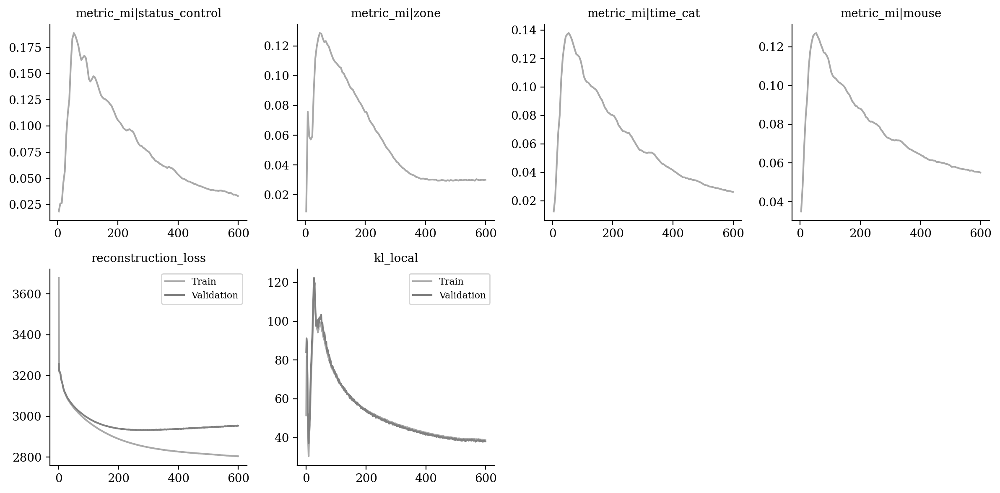

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

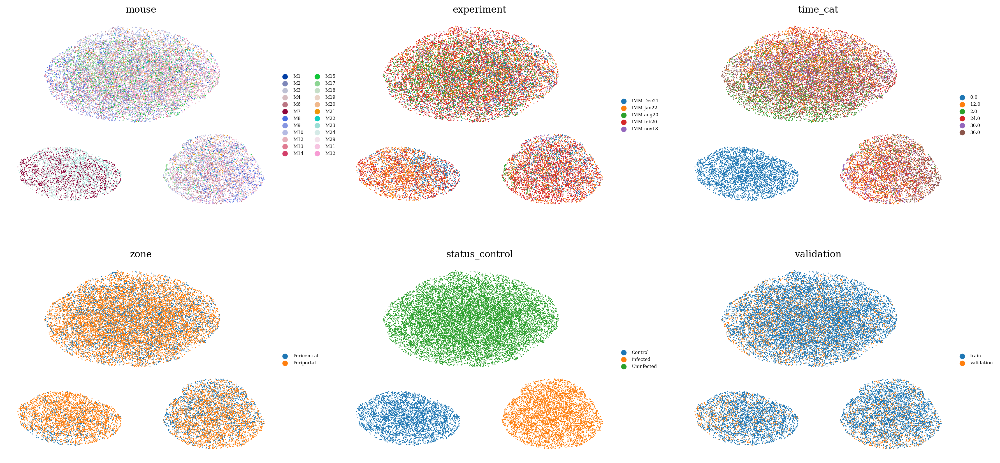

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

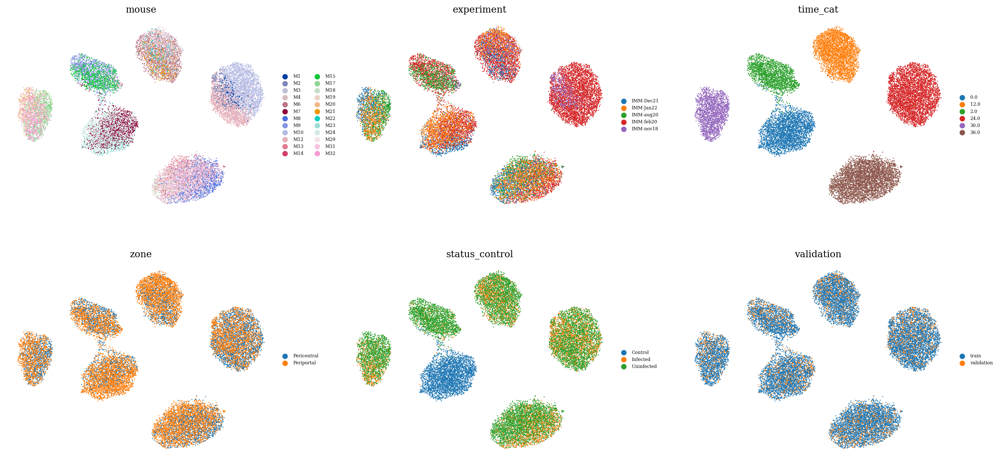

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

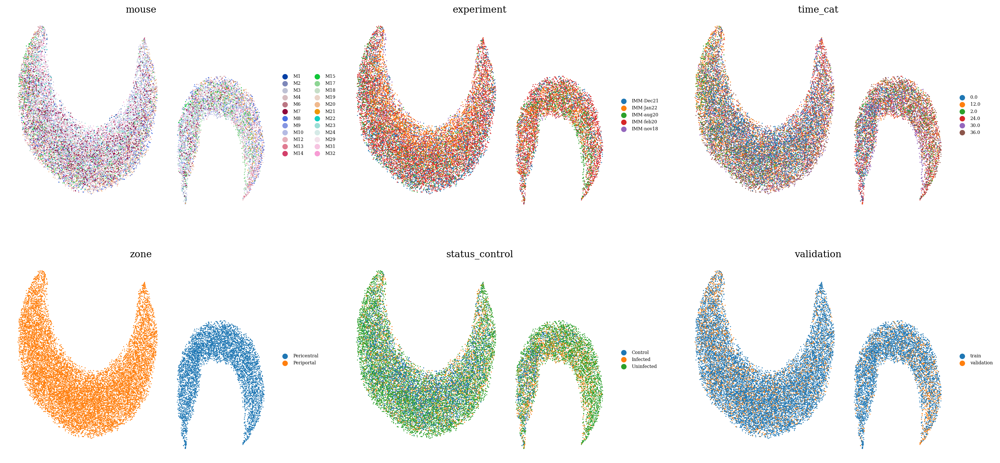

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

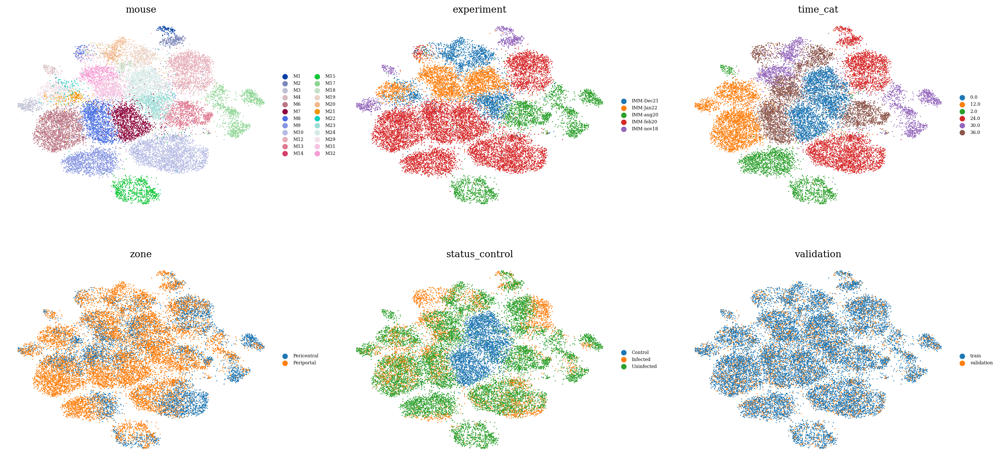

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

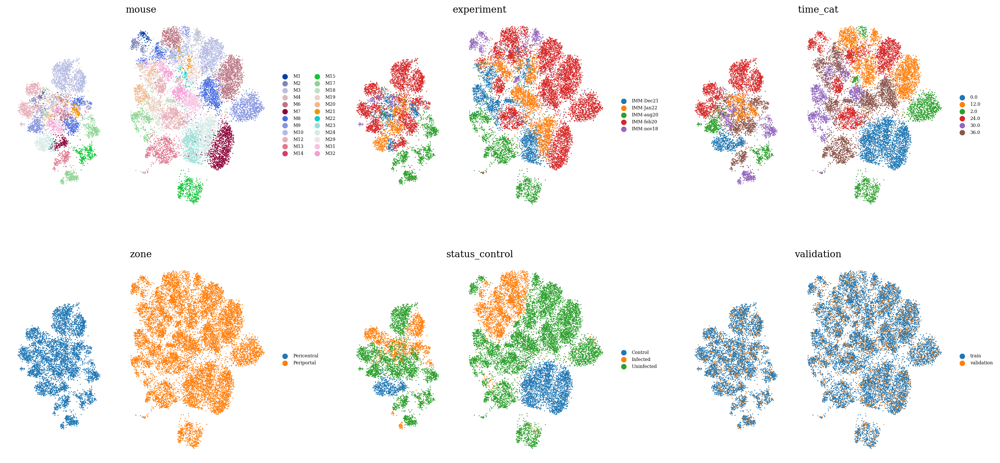

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

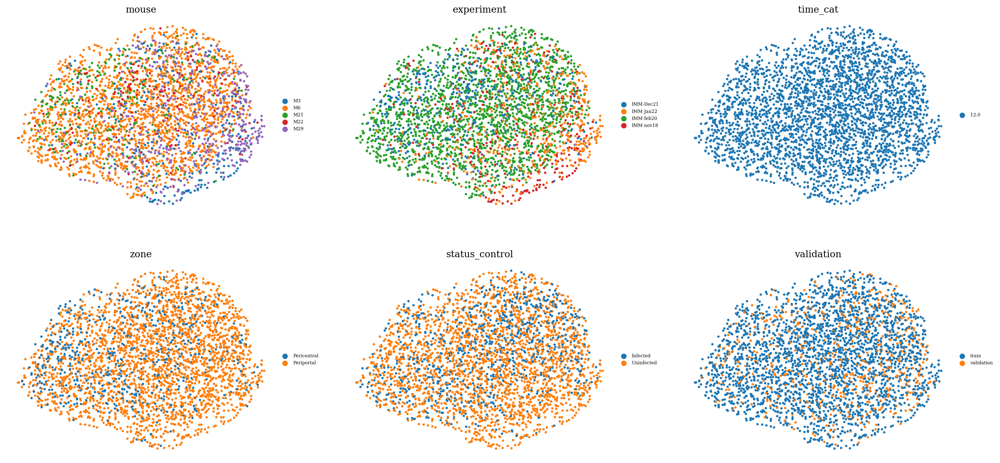

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )